In [2]:
import tensorflow as tf
print("Tensor version" + tf.__version__)
print(tf.config.list_physical_devices('GPU'))

import pathlib
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
#from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

Tensor version2.13.1
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [3]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

In [8]:
# NOTE: Update these TFRecord names from "cells" and "cells_label_map" to your files!
test_record_fname = '/home/759635/Endo-1/test/endometriosis.tfrecord'
train_record_fname = '/home/759635/Endo-1/train/endometriosis.tfrecord'
label_map_pbtxt_fname = '/home/759635/Endo-1/train/endometriosis_label_map.pbtxt'

In [37]:
##change chosen model to deploy different models available in the TF2 object detection zoo
MODELS_CONFIG = {
    'efficientdet-d0': {
        'model_name': 'faster_rcnn_inception_resnet_v2_keras',
        'base_pipeline_file': 'faster_rcnn_resnet50_v1_1024x1024_coco17_tpu-8.config',
        'pretrained_checkpoint': 'faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8.tar.gz',
        'batch_size': 1
    },
}
#in this tutorial we implement the lightweight, smallest state of the art efficientdet model
#if you want to scale up tot larger efficientdet models you will likely need more compute!
chosen_model = 'efficientdet-d0'

num_steps = 80000 #The more steps, the longer the training. Increase if your loss function is still decreasing and validation metrics are increasing. 
num_eval_steps = 10000 #Perform evaluation after so many steps

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size'] #if you can fit a large batch in memory, it may speed up your training

In [6]:
# Optional: Get model here, if you did not download from the model zoo
# %mkdir "C:\Users\awick\Desktop\my_tfod\my_tfod\research\deploy"
%cd "/home/759635/models/research/deploy/"
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

/home/759635/models/research/deploy
--2023-10-21 03:12:37--  http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 216.58.204.91, 142.250.200.59, 172.217.169.91, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|216.58.204.91|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 447961769 (427M) [application/x-tar]
Saving to: ‘faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8.tar.gz’

100%[======================================>] 447,961,769 30.2MB/s   in 15s    

2023-10-21 03:12:53 (28.0 MB/s) - ‘faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8.tar.gz’ saved [447961769/447961769]



In [18]:
#prepare
pipeline_fname = "/home/759635/models/research/deploy/faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8/pipeline.config"
fine_tune_checkpoint_fasterrcnn = "/home/759635/models/research/deploy/faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8/checkpoint/ckpt-0"

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)


In [10]:
num_classes

4

In [19]:
#write custom configuration file by slotting our dataset, model checkpoint, and training parameters into the base pipeline file

import re

%cd /home/759635/models/research/deploy
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:

    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint_fasterrcnn), s)

    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    #fine-tune checkpoint type
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    f.write(s)



/home/759635/models/research/deploy
writing custom configuration file


In [38]:
%cat /home/759635/models/research/deploy/pipeline_file.config

# Faster R-CNN with Inception Resnet v2 (no atrous)
# Sync-trained on COCO (with 8 GPUs) with batch size 16 (800x1333 resolution)
# Initialized from Imagenet classification checkpoint
# TF2-Compatible, *Not* TPU-Compatible
#
# Achieves 39.6 mAP on COCO

model {
  faster_rcnn {
    num_classes: 4
    image_resizer {
      keep_aspect_ratio_resizer {
        min_dimension: 360
        max_dimension: 640
        pad_to_max_dimension: true
      }
    }
    feature_extractor {
      type: 'faster_rcnn_inception_resnet_v2_keras'
    }
    first_stage_anchor_generator {
      grid_anchor_generator {
        scales: [0.25, 0.5, 1.0, 2.0]
        aspect_ratios: [0.5, 1.0, 2.0]
        height_stride: 16
        width_stride: 16
      }
    }
    first_stage_box_predictor_conv_hyperparams {
      op: CONV
      regularizer {
        l2_regularizer {
          weight: 0.0
        }
      }
      initializer {
        truncated_normal_initializer {
          stddev: 0.01
        }
      }
    }
  

In [39]:
pipeline_file = '/home/759635/models/research/deploy/pipeline_file.config'
model_dir = '/home/759635/training_fastercnn/'

In [ ]:
## reduced training steps to 100000 due to insufficient GPU memory

In [32]:
!python /home/759635/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2023-10-21 04:04:28.974236: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-21 04:04:30.857584: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-10-21 04:04:36.018341: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 215 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:02:00.0, compute capability: 8.6
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1021 04:04:36.024187 139641545291584 mirrored_strategy.py:419] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 100000
I1021 04:0

    strategy.run(
  File "/home/759635/.local/lib/python3.10/site-packages/tensorflow/python/distribute/distribute_lib.py", line 1673, in run
    return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
  File "/home/759635/.local/lib/python3.10/site-packages/tensorflow/python/distribute/distribute_lib.py", line 3250, in call_for_each_replica
    return self._call_for_each_replica(fn, args, kwargs)
  File "/home/759635/.local/lib/python3.10/site-packages/tensorflow/python/distribute/mirrored_strategy.py", line 696, in _call_for_each_replica
    return mirrored_run.call_for_each_replica(
  File "/home/759635/.local/lib/python3.10/site-packages/tensorflow/python/distribute/mirrored_run.py", line 84, in call_for_each_replica
    return wrapped(*args, **kwargs)
  File "/home/759635/.local/lib/python3.10/site-packages/tensorflow/python/util/traceback_utils.py", line 153, in error_handler
    raise e.with_traceback(filtered_tb) from None
  File "/home/759635/.local/lib/pytho

## reduced training steps to 80000 from 1000000 due to insufficient GPU memory
I am not sure this model will perform quite well, because the longer the training time, the better the model performance

In [40]:
!python /home/759635/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2023-10-21 04:16:36.338398: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-21 04:16:38.257192: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-10-21 04:16:43.813396: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43355 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:02:00.0, compute capability: 8.6
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1021 04:16:43.819950 140402888517440 mirrored_strategy.py:419] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 80000
I1021 04:

2023-10-21 04:17:29.512746: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8800
2023-10-21 04:17:31.369102: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
Instructions for updating:
Use fn_output_signature instead
W1021 04:17:44.775057 140399352497920 deprecation.py:569] From /home/759635/.local/lib/python3.10/site-packages/tensorflow/python/util/deprecation.py:648: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Use fn_output_signature instead
INFO:tensorflow:Step 1100 per-step time 0.820s
I1021 04:19:06.570362 140402888517440 model_lib_v2.py:705] Step 1100 per-step time 0.820s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.6176509,
 'Loss/BoxClassifierLoss/localization_loss': 0.28517517,
 'Loss/RPNLoss/localization_loss': 0.0

INFO:tensorflow:Step 2000 per-step time 0.178s
I1021 04:21:28.755115 140402888517440 model_lib_v2.py:705] Step 2000 per-step time 0.178s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.43807378,
 'Loss/BoxClassifierLoss/localization_loss': 0.40576515,
 'Loss/RPNLoss/localization_loss': 0.04232593,
 'Loss/RPNLoss/objectness_loss': 0.05265384,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.9388187,
 'learning_rate': 0.0032000002}
I1021 04:21:28.755729 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.43807378,
 'Loss/BoxClassifierLoss/localization_loss': 0.40576515,
 'Loss/RPNLoss/localization_loss': 0.04232593,
 'Loss/RPNLoss/objectness_loss': 0.05265384,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.9388187,
 'learning_rate': 0.0032000002}
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
I1021 04:21:29.839853 140402888517440 

INFO:tensorflow:Step 2600 per-step time 0.190s
I1021 04:23:23.529036 140402888517440 model_lib_v2.py:705] Step 2600 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.24561778,
 'Loss/BoxClassifierLoss/localization_loss': 0.33203056,
 'Loss/RPNLoss/localization_loss': 0.14702843,
 'Loss/RPNLoss/objectness_loss': 0.041716352,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.7663931,
 'learning_rate': 0.0041600005}
I1021 04:23:23.529675 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.24561778,
 'Loss/BoxClassifierLoss/localization_loss': 0.33203056,
 'Loss/RPNLoss/localization_loss': 0.14702843,
 'Loss/RPNLoss/objectness_loss': 0.041716352,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.7663931,
 'learning_rate': 0.0041600005}
INFO:tensorflow:Step 2700 per-step time 0.190s
I1021 04:23:42.553703 140402888517440 model_lib_v2.py:705] Step 2700 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLos

INFO:tensorflow:Step 3700 per-step time 0.193s
I1021 04:26:55.352913 140402888517440 model_lib_v2.py:705] Step 3700 per-step time 0.193s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.29257017,
 'Loss/BoxClassifierLoss/localization_loss': 0.90758044,
 'Loss/RPNLoss/localization_loss': 0.0120669175,
 'Loss/RPNLoss/objectness_loss': 0.011873677,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.2240913,
 'learning_rate': 0.0059200004}
I1021 04:26:55.353447 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.29257017,
 'Loss/BoxClassifierLoss/localization_loss': 0.90758044,
 'Loss/RPNLoss/localization_loss': 0.0120669175,
 'Loss/RPNLoss/objectness_loss': 0.011873677,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.2240913,
 'learning_rate': 0.0059200004}
INFO:tensorflow:Step 3800 per-step time 0.193s
I1021 04:27:14.626768 140402888517440 model_lib_v2.py:705] Step 3800 per-step time 0.193s
INFO:tensorflow:{'Loss/BoxClassifie

INFO:tensorflow:Step 4700 per-step time 0.186s
I1021 04:30:06.541393 140402888517440 model_lib_v2.py:705] Step 4700 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.019235976,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.2884605,
 'Loss/RPNLoss/objectness_loss': 0.010531251,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.3182277,
 'learning_rate': 0.0075200005}
I1021 04:30:06.541678 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.019235976,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.2884605,
 'Loss/RPNLoss/objectness_loss': 0.010531251,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.3182277,
 'learning_rate': 0.0075200005}
INFO:tensorflow:Step 4800 per-step time 0.191s
I1021 04:30:25.674714 140402888517440 model_lib_v2.py:705] Step 4800 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classificati

INFO:tensorflow:Step 5800 per-step time 0.187s
I1021 04:33:37.533288 140402888517440 model_lib_v2.py:705] Step 5800 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.049345087,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.0,
 'Loss/RPNLoss/objectness_loss': 0.0035342316,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.05287932,
 'learning_rate': 0.007997754}
I1021 04:33:37.533886 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.049345087,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.0,
 'Loss/RPNLoss/objectness_loss': 0.0035342316,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.05287932,
 'learning_rate': 0.007997754}
INFO:tensorflow:Step 5900 per-step time 0.190s
I1021 04:33:56.495312 140402888517440 model_lib_v2.py:705] Step 5900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 

INFO:tensorflow:Step 6900 per-step time 0.184s
I1021 04:37:09.337341 140402888517440 model_lib_v2.py:705] Step 6900 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.80279815,
 'Loss/BoxClassifierLoss/localization_loss': 0.6720457,
 'Loss/RPNLoss/localization_loss': 0.024887333,
 'Loss/RPNLoss/objectness_loss': 0.038980935,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.5387121,
 'learning_rate': 0.007987339}
I1021 04:37:09.337918 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.80279815,
 'Loss/BoxClassifierLoss/localization_loss': 0.6720457,
 'Loss/RPNLoss/localization_loss': 0.024887333,
 'Loss/RPNLoss/objectness_loss': 0.038980935,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.5387121,
 'learning_rate': 0.007987339}
INFO:tensorflow:Step 7000 per-step time 0.197s
I1021 04:37:28.996713 140402888517440 model_lib_v2.py:705] Step 7000 per-step time 0.197s
INFO:tensorflow:{'Loss/BoxClassifierLoss/

INFO:tensorflow:Step 7900 per-step time 0.187s
I1021 04:40:22.017220 140402888517440 model_lib_v2.py:705] Step 7900 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.16418345,
 'Loss/BoxClassifierLoss/localization_loss': 0.22411802,
 'Loss/RPNLoss/localization_loss': 0.0069313045,
 'Loss/RPNLoss/objectness_loss': 0.0035064798,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.39873928,
 'learning_rate': 0.007970524}
I1021 04:40:22.017796 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.16418345,
 'Loss/BoxClassifierLoss/localization_loss': 0.22411802,
 'Loss/RPNLoss/localization_loss': 0.0069313045,
 'Loss/RPNLoss/objectness_loss': 0.0035064798,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.39873928,
 'learning_rate': 0.007970524}
INFO:tensorflow:Step 8000 per-step time 0.188s
I1021 04:40:40.791485 140402888517440 model_lib_v2.py:705] Step 8000 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassif

INFO:tensorflow:Step 8900 per-step time 0.196s
I1021 04:43:35.377870 140402888517440 model_lib_v2.py:705] Step 8900 per-step time 0.196s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.3538047,
 'Loss/BoxClassifierLoss/localization_loss': 0.40653062,
 'Loss/RPNLoss/localization_loss': 0.05669291,
 'Loss/RPNLoss/objectness_loss': 0.072615005,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.88964325,
 'learning_rate': 0.007946745}
I1021 04:43:35.378184 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.3538047,
 'Loss/BoxClassifierLoss/localization_loss': 0.40653062,
 'Loss/RPNLoss/localization_loss': 0.05669291,
 'Loss/RPNLoss/objectness_loss': 0.072615005,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.88964325,
 'learning_rate': 0.007946745}
INFO:tensorflow:Step 9000 per-step time 0.192s
I1021 04:43:54.627572 140402888517440 model_lib_v2.py:705] Step 9000 per-step time 0.192s
INFO:tensorflow:{'Loss/BoxClassifierLoss/

INFO:tensorflow:Step 9900 per-step time 0.189s
I1021 04:46:48.386480 140402888517440 model_lib_v2.py:705] Step 9900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.19315301,
 'Loss/BoxClassifierLoss/localization_loss': 0.401889,
 'Loss/RPNLoss/localization_loss': 0.0716096,
 'Loss/RPNLoss/objectness_loss': 0.020116607,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.68676823,
 'learning_rate': 0.00791604}
I1021 04:46:48.387113 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.19315301,
 'Loss/BoxClassifierLoss/localization_loss': 0.401889,
 'Loss/RPNLoss/localization_loss': 0.0716096,
 'Loss/RPNLoss/objectness_loss': 0.020116607,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.68676823,
 'learning_rate': 0.00791604}
INFO:tensorflow:Step 10000 per-step time 0.183s
I1021 04:47:06.665441 140402888517440 model_lib_v2.py:705] Step 10000 per-step time 0.183s
INFO:tensorflow:{'Loss/BoxClassifierLoss/clas

INFO:tensorflow:Step 10900 per-step time 0.188s
I1021 04:49:58.143517 140402888517440 model_lib_v2.py:705] Step 10900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.06271455,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.01649982,
 'Loss/RPNLoss/objectness_loss': 0.064294435,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.14350879,
 'learning_rate': 0.007878466}
I1021 04:49:58.144102 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.06271455,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.01649982,
 'Loss/RPNLoss/objectness_loss': 0.064294435,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.14350879,
 'learning_rate': 0.007878466}
INFO:tensorflow:Step 11000 per-step time 0.189s
I1021 04:50:17.041595 140402888517440 model_lib_v2.py:705] Step 11000 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classifi

INFO:tensorflow:Step 11900 per-step time 0.188s
I1021 04:53:10.874665 140402888517440 model_lib_v2.py:705] Step 11900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.10688695,
 'Loss/BoxClassifierLoss/localization_loss': 0.3702563,
 'Loss/RPNLoss/localization_loss': 0.06966427,
 'Loss/RPNLoss/objectness_loss': 0.014969837,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.56177735,
 'learning_rate': 0.007834088}
I1021 04:53:10.875289 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.10688695,
 'Loss/BoxClassifierLoss/localization_loss': 0.3702563,
 'Loss/RPNLoss/localization_loss': 0.06966427,
 'Loss/RPNLoss/objectness_loss': 0.014969837,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.56177735,
 'learning_rate': 0.007834088}
INFO:tensorflow:Step 12000 per-step time 0.189s
I1021 04:53:29.727978 140402888517440 model_lib_v2.py:705] Step 12000 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierL

INFO:tensorflow:Step 12900 per-step time 0.189s
I1021 04:56:22.403858 140402888517440 model_lib_v2.py:705] Step 12900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.10827392,
 'Loss/BoxClassifierLoss/localization_loss': 0.24033041,
 'Loss/RPNLoss/localization_loss': 0.0022672368,
 'Loss/RPNLoss/objectness_loss': 0.007741094,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.35861266,
 'learning_rate': 0.007782983}
I1021 04:56:22.404150 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.10827392,
 'Loss/BoxClassifierLoss/localization_loss': 0.24033041,
 'Loss/RPNLoss/localization_loss': 0.0022672368,
 'Loss/RPNLoss/objectness_loss': 0.007741094,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.35861266,
 'learning_rate': 0.007782983}
INFO:tensorflow:Step 13000 per-step time 0.189s
I1021 04:56:41.335905 140402888517440 model_lib_v2.py:705] Step 13000 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClass

INFO:tensorflow:Step 13900 per-step time 0.191s
I1021 04:59:34.300341 140402888517440 model_lib_v2.py:705] Step 13900 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.049008235,
 'Loss/BoxClassifierLoss/localization_loss': 0.17165627,
 'Loss/RPNLoss/localization_loss': 0.0115540745,
 'Loss/RPNLoss/objectness_loss': 0.002554647,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.23477322,
 'learning_rate': 0.0077252416}
I1021 04:59:34.300684 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.049008235,
 'Loss/BoxClassifierLoss/localization_loss': 0.17165627,
 'Loss/RPNLoss/localization_loss': 0.0115540745,
 'Loss/RPNLoss/objectness_loss': 0.002554647,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.23477322,
 'learning_rate': 0.0077252416}
INFO:tensorflow:Step 14000 per-step time 0.191s
I1021 04:59:53.414815 140402888517440 model_lib_v2.py:705] Step 14000 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 14900 per-step time 0.182s
I1021 05:02:45.483383 140402888517440 model_lib_v2.py:705] Step 14900 per-step time 0.182s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.2932293,
 'Loss/BoxClassifierLoss/localization_loss': 0.46888253,
 'Loss/RPNLoss/localization_loss': 0.045091588,
 'Loss/RPNLoss/objectness_loss': 0.0032042086,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.81040764,
 'learning_rate': 0.0076609654}
I1021 05:02:45.483697 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.2932293,
 'Loss/BoxClassifierLoss/localization_loss': 0.46888253,
 'Loss/RPNLoss/localization_loss': 0.045091588,
 'Loss/RPNLoss/objectness_loss': 0.0032042086,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.81040764,
 'learning_rate': 0.0076609654}
INFO:tensorflow:Step 15000 per-step time 0.185s
I1021 05:03:03.951335 140402888517440 model_lib_v2.py:705] Step 15000 per-step time 0.185s
INFO:tensorflow:{'Loss/BoxClass

INFO:tensorflow:Step 15900 per-step time 0.195s
I1021 05:05:57.557500 140402888517440 model_lib_v2.py:705] Step 15900 per-step time 0.195s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.06633135,
 'Loss/BoxClassifierLoss/localization_loss': 0.24308029,
 'Loss/RPNLoss/localization_loss': 0.014043879,
 'Loss/RPNLoss/objectness_loss': 0.005319681,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.3287752,
 'learning_rate': 0.0075902655}
I1021 05:05:57.558122 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.06633135,
 'Loss/BoxClassifierLoss/localization_loss': 0.24308029,
 'Loss/RPNLoss/localization_loss': 0.014043879,
 'Loss/RPNLoss/objectness_loss': 0.005319681,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.3287752,
 'learning_rate': 0.0075902655}
INFO:tensorflow:Step 16000 per-step time 0.194s
I1021 05:06:16.941119 140402888517440 model_lib_v2.py:705] Step 16000 per-step time 0.194s
INFO:tensorflow:{'Loss/BoxClassif

INFO:tensorflow:Step 16900 per-step time 0.190s
I1021 05:09:08.786367 140402888517440 model_lib_v2.py:705] Step 16900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.17033081,
 'Loss/BoxClassifierLoss/localization_loss': 0.4857826,
 'Loss/RPNLoss/localization_loss': 0.010694873,
 'Loss/RPNLoss/objectness_loss': 0.013360531,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.6801688,
 'learning_rate': 0.007513268}
I1021 05:09:08.786666 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.17033081,
 'Loss/BoxClassifierLoss/localization_loss': 0.4857826,
 'Loss/RPNLoss/localization_loss': 0.010694873,
 'Loss/RPNLoss/objectness_loss': 0.013360531,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.6801688,
 'learning_rate': 0.007513268}
INFO:tensorflow:Step 17000 per-step time 0.190s
I1021 05:09:27.809196 140402888517440 model_lib_v2.py:705] Step 17000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierL

INFO:tensorflow:Step 17900 per-step time 0.190s
I1021 05:12:20.676424 140402888517440 model_lib_v2.py:705] Step 17900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.17734237,
 'Loss/BoxClassifierLoss/localization_loss': 0.35098332,
 'Loss/RPNLoss/localization_loss': 0.022372266,
 'Loss/RPNLoss/objectness_loss': 0.0054734387,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.55617136,
 'learning_rate': 0.007430107}
I1021 05:12:20.676809 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.17734237,
 'Loss/BoxClassifierLoss/localization_loss': 0.35098332,
 'Loss/RPNLoss/localization_loss': 0.022372266,
 'Loss/RPNLoss/objectness_loss': 0.0054734387,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.55617136,
 'learning_rate': 0.007430107}
INFO:tensorflow:Step 18000 per-step time 0.190s
I1021 05:12:39.661287 140402888517440 model_lib_v2.py:705] Step 18000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClass

INFO:tensorflow:Step 18900 per-step time 0.187s
I1021 05:15:32.067223 140402888517440 model_lib_v2.py:705] Step 18900 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.16780245,
 'Loss/BoxClassifierLoss/localization_loss': 0.2411569,
 'Loss/RPNLoss/localization_loss': 0.03205594,
 'Loss/RPNLoss/objectness_loss': 0.008638066,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.44965336,
 'learning_rate': 0.0073409285}
I1021 05:15:32.067794 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.16780245,
 'Loss/BoxClassifierLoss/localization_loss': 0.2411569,
 'Loss/RPNLoss/localization_loss': 0.03205594,
 'Loss/RPNLoss/objectness_loss': 0.008638066,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.44965336,
 'learning_rate': 0.0073409285}
INFO:tensorflow:Step 19000 per-step time 0.187s
I1021 05:15:50.794368 140402888517440 model_lib_v2.py:705] Step 19000 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifie

INFO:tensorflow:Step 19900 per-step time 0.185s
I1021 05:18:44.286720 140402888517440 model_lib_v2.py:705] Step 19900 per-step time 0.185s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.29337758,
 'Loss/BoxClassifierLoss/localization_loss': 0.40704784,
 'Loss/RPNLoss/localization_loss': 0.3596252,
 'Loss/RPNLoss/objectness_loss': 0.07050228,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.1305529,
 'learning_rate': 0.007245888}
I1021 05:18:44.287003 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.29337758,
 'Loss/BoxClassifierLoss/localization_loss': 0.40704784,
 'Loss/RPNLoss/localization_loss': 0.3596252,
 'Loss/RPNLoss/objectness_loss': 0.07050228,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.1305529,
 'learning_rate': 0.007245888}
INFO:tensorflow:Step 20000 per-step time 0.186s
I1021 05:19:02.919328 140402888517440 model_lib_v2.py:705] Step 20000 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/

INFO:tensorflow:Step 20900 per-step time 0.184s
I1021 05:21:55.985072 140402888517440 model_lib_v2.py:705] Step 20900 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.02159034,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.026174055,
 'Loss/RPNLoss/objectness_loss': 0.018769184,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.06653358,
 'learning_rate': 0.0071451543}
I1021 05:21:55.985373 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.02159034,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.026174055,
 'Loss/RPNLoss/objectness_loss': 0.018769184,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.06653358,
 'learning_rate': 0.0071451543}
INFO:tensorflow:Step 21000 per-step time 0.190s
I1021 05:22:14.988372 140402888517440 model_lib_v2.py:705] Step 21000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/clas

INFO:tensorflow:Step 21900 per-step time 0.186s
I1021 05:25:08.071237 140402888517440 model_lib_v2.py:705] Step 21900 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.4483315,
 'Loss/BoxClassifierLoss/localization_loss': 0.095537536,
 'Loss/RPNLoss/localization_loss': 0.0076947813,
 'Loss/RPNLoss/objectness_loss': 0.0017528628,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.55331665,
 'learning_rate': 0.007038902}
I1021 05:25:08.071529 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.4483315,
 'Loss/BoxClassifierLoss/localization_loss': 0.095537536,
 'Loss/RPNLoss/localization_loss': 0.0076947813,
 'Loss/RPNLoss/objectness_loss': 0.0017528628,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.55331665,
 'learning_rate': 0.007038902}
INFO:tensorflow:Step 22000 per-step time 0.186s
I1021 05:25:26.678377 140402888517440 model_lib_v2.py:705] Step 22000 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 22900 per-step time 0.186s
I1021 05:28:20.710343 140402888517440 model_lib_v2.py:705] Step 22900 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.12519932,
 'Loss/BoxClassifierLoss/localization_loss': 0.49305916,
 'Loss/RPNLoss/localization_loss': 0.007786712,
 'Loss/RPNLoss/objectness_loss': 0.003693992,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.62973917,
 'learning_rate': 0.006927319}
I1021 05:28:20.710655 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.12519932,
 'Loss/BoxClassifierLoss/localization_loss': 0.49305916,
 'Loss/RPNLoss/localization_loss': 0.007786712,
 'Loss/RPNLoss/objectness_loss': 0.003693992,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.62973917,
 'learning_rate': 0.006927319}
INFO:tensorflow:Step 23000 per-step time 0.190s
I1021 05:28:39.727860 140402888517440 model_lib_v2.py:705] Step 23000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassif

INFO:tensorflow:Step 23900 per-step time 0.188s
I1021 05:31:31.163531 140402888517440 model_lib_v2.py:705] Step 23900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.17610711,
 'Loss/BoxClassifierLoss/localization_loss': 0.24447906,
 'Loss/RPNLoss/localization_loss': 0.00978395,
 'Loss/RPNLoss/objectness_loss': 0.0082656285,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.43863574,
 'learning_rate': 0.0068106}
I1021 05:31:31.163860 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.17610711,
 'Loss/BoxClassifierLoss/localization_loss': 0.24447906,
 'Loss/RPNLoss/localization_loss': 0.00978395,
 'Loss/RPNLoss/objectness_loss': 0.0082656285,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.43863574,
 'learning_rate': 0.0068106}
INFO:tensorflow:Step 24000 per-step time 0.187s
I1021 05:31:49.911568 140402888517440 model_lib_v2.py:705] Step 24000 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierL

INFO:tensorflow:Step 24900 per-step time 0.184s
I1021 05:34:43.005397 140402888517440 model_lib_v2.py:705] Step 24900 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.07589671,
 'Loss/BoxClassifierLoss/localization_loss': 0.05654462,
 'Loss/RPNLoss/localization_loss': 0.015604937,
 'Loss/RPNLoss/objectness_loss': 0.00073111505,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.14877738,
 'learning_rate': 0.006688951}
I1021 05:34:43.005686 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.07589671,
 'Loss/BoxClassifierLoss/localization_loss': 0.05654462,
 'Loss/RPNLoss/localization_loss': 0.015604937,
 'Loss/RPNLoss/objectness_loss': 0.00073111505,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.14877738,
 'learning_rate': 0.006688951}
INFO:tensorflow:Step 25000 per-step time 0.189s
I1021 05:35:01.892852 140402888517440 model_lib_v2.py:705] Step 25000 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 25900 per-step time 0.195s
I1021 05:37:55.013598 140402888517440 model_lib_v2.py:705] Step 25900 per-step time 0.195s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.96446216,
 'Loss/BoxClassifierLoss/localization_loss': 0.2883489,
 'Loss/RPNLoss/localization_loss': 0.017278094,
 'Loss/RPNLoss/objectness_loss': 0.011957604,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.2820468,
 'learning_rate': 0.006562584}
I1021 05:37:55.013920 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.96446216,
 'Loss/BoxClassifierLoss/localization_loss': 0.2883489,
 'Loss/RPNLoss/localization_loss': 0.017278094,
 'Loss/RPNLoss/objectness_loss': 0.011957604,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 1.2820468,
 'learning_rate': 0.006562584}
INFO:tensorflow:Step 26000 per-step time 0.200s
I1021 05:38:15.045111 140402888517440 model_lib_v2.py:705] Step 26000 per-step time 0.200s
INFO:tensorflow:{'Loss/BoxClassifierL

INFO:tensorflow:Step 26900 per-step time 0.188s
I1021 05:41:06.777492 140402888517440 model_lib_v2.py:705] Step 26900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.33699024,
 'Loss/BoxClassifierLoss/localization_loss': 0.38703853,
 'Loss/RPNLoss/localization_loss': 0.07229202,
 'Loss/RPNLoss/objectness_loss': 0.027965853,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.82428664,
 'learning_rate': 0.006431721}
I1021 05:41:06.778093 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.33699024,
 'Loss/BoxClassifierLoss/localization_loss': 0.38703853,
 'Loss/RPNLoss/localization_loss': 0.07229202,
 'Loss/RPNLoss/objectness_loss': 0.027965853,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.82428664,
 'learning_rate': 0.006431721}
INFO:tensorflow:Step 27000 per-step time 0.189s
I1021 05:41:25.654724 140402888517440 model_lib_v2.py:705] Step 27000 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifie

INFO:tensorflow:Step 27900 per-step time 0.184s
I1021 05:44:18.855717 140402888517440 model_lib_v2.py:705] Step 27900 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.02611075,
 'Loss/BoxClassifierLoss/localization_loss': 0.09309428,
 'Loss/RPNLoss/localization_loss': 0.000460786,
 'Loss/RPNLoss/objectness_loss': 0.00052355346,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.12018937,
 'learning_rate': 0.006296593}
I1021 05:44:18.856010 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.02611075,
 'Loss/BoxClassifierLoss/localization_loss': 0.09309428,
 'Loss/RPNLoss/localization_loss': 0.000460786,
 'Loss/RPNLoss/objectness_loss': 0.00052355346,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.12018937,
 'learning_rate': 0.006296593}
INFO:tensorflow:Step 28000 per-step time 0.186s
I1021 05:44:37.485179 140402888517440 model_lib_v2.py:705] Step 28000 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 28900 per-step time 0.184s
I1021 05:47:31.531355 140402888517440 model_lib_v2.py:705] Step 28900 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.031260468,
 'Loss/BoxClassifierLoss/localization_loss': 0.047677297,
 'Loss/RPNLoss/localization_loss': 0.00024459252,
 'Loss/RPNLoss/objectness_loss': 0.0011081499,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08029051,
 'learning_rate': 0.006157435}
I1021 05:47:31.531641 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.031260468,
 'Loss/BoxClassifierLoss/localization_loss': 0.047677297,
 'Loss/RPNLoss/localization_loss': 0.00024459252,
 'Loss/RPNLoss/objectness_loss': 0.0011081499,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08029051,
 'learning_rate': 0.006157435}
INFO:tensorflow:Step 29000 per-step time 0.183s
I1021 05:47:49.838772 140402888517440 model_lib_v2.py:705] Step 29000 per-step time 0.183s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 29900 per-step time 0.188s
I1021 05:50:43.379298 140402888517440 model_lib_v2.py:705] Step 29900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.03927377,
 'Loss/BoxClassifierLoss/localization_loss': 0.07888589,
 'Loss/RPNLoss/localization_loss': 0.0018451276,
 'Loss/RPNLoss/objectness_loss': 0.0011049628,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.121109754,
 'learning_rate': 0.006014493}
I1021 05:50:43.379906 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.03927377,
 'Loss/BoxClassifierLoss/localization_loss': 0.07888589,
 'Loss/RPNLoss/localization_loss': 0.0018451276,
 'Loss/RPNLoss/objectness_loss': 0.0011049628,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.121109754,
 'learning_rate': 0.006014493}
INFO:tensorflow:Step 30000 per-step time 0.188s
I1021 05:51:02.090049 140402888517440 model_lib_v2.py:705] Step 30000 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 30900 per-step time 0.195s
I1021 05:53:55.824197 140402888517440 model_lib_v2.py:705] Step 30900 per-step time 0.195s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.060280215,
 'Loss/BoxClassifierLoss/localization_loss': 0.09125674,
 'Loss/RPNLoss/localization_loss': 0.0029525063,
 'Loss/RPNLoss/objectness_loss': 0.0011066936,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.15559615,
 'learning_rate': 0.0058680167}
I1021 05:53:55.824488 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.060280215,
 'Loss/BoxClassifierLoss/localization_loss': 0.09125674,
 'Loss/RPNLoss/localization_loss': 0.0029525063,
 'Loss/RPNLoss/objectness_loss': 0.0011066936,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.15559615,
 'learning_rate': 0.0058680167}
INFO:tensorflow:Step 31000 per-step time 0.188s
I1021 05:54:14.576061 140402888517440 model_lib_v2.py:705] Step 31000 per-step time 0.188s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 31900 per-step time 0.184s
I1021 05:57:06.422474 140402888517440 model_lib_v2.py:705] Step 31900 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.0020032928,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.0,
 'Loss/RPNLoss/objectness_loss': 0.00045953025,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.002462823,
 'learning_rate': 0.005718263}
I1021 05:57:06.422861 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.0020032928,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.0,
 'Loss/RPNLoss/objectness_loss': 0.00045953025,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.002462823,
 'learning_rate': 0.005718263}
INFO:tensorflow:Step 32000 per-step time 0.184s
I1021 05:57:24.839952 140402888517440 model_lib_v2.py:705] Step 32000 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classificati

INFO:tensorflow:Step 32900 per-step time 0.190s
I1021 06:00:17.744027 140402888517440 model_lib_v2.py:705] Step 32900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.16702437,
 'Loss/BoxClassifierLoss/localization_loss': 0.48651567,
 'Loss/RPNLoss/localization_loss': 0.023084234,
 'Loss/RPNLoss/objectness_loss': 0.022716418,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.69934064,
 'learning_rate': 0.0055654948}
I1021 06:00:17.744325 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.16702437,
 'Loss/BoxClassifierLoss/localization_loss': 0.48651567,
 'Loss/RPNLoss/localization_loss': 0.023084234,
 'Loss/RPNLoss/objectness_loss': 0.022716418,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.69934064,
 'learning_rate': 0.0055654948}
INFO:tensorflow:Step 33000 per-step time 0.190s
I1021 06:00:36.723026 140402888517440 model_lib_v2.py:705] Step 33000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClass

INFO:tensorflow:Step 33900 per-step time 0.190s
I1021 06:03:30.377758 140402888517440 model_lib_v2.py:705] Step 33900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.05222125,
 'Loss/BoxClassifierLoss/localization_loss': 0.020159896,
 'Loss/RPNLoss/localization_loss': 0.0007539732,
 'Loss/RPNLoss/objectness_loss': 0.002013249,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.075148374,
 'learning_rate': 0.00540998}
I1021 06:03:30.378077 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.05222125,
 'Loss/BoxClassifierLoss/localization_loss': 0.020159896,
 'Loss/RPNLoss/localization_loss': 0.0007539732,
 'Loss/RPNLoss/objectness_loss': 0.002013249,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.075148374,
 'learning_rate': 0.00540998}
INFO:tensorflow:Step 34000 per-step time 0.190s
I1021 06:03:49.398687 140402888517440 model_lib_v2.py:705] Step 34000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 34900 per-step time 0.192s
I1021 06:06:42.616189 140402888517440 model_lib_v2.py:705] Step 34900 per-step time 0.192s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.19352879,
 'Loss/BoxClassifierLoss/localization_loss': 0.3406981,
 'Loss/RPNLoss/localization_loss': 0.008677627,
 'Loss/RPNLoss/objectness_loss': 0.0029857696,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.5458903,
 'learning_rate': 0.0052519925}
I1021 06:06:42.616474 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.19352879,
 'Loss/BoxClassifierLoss/localization_loss': 0.3406981,
 'Loss/RPNLoss/localization_loss': 0.008677627,
 'Loss/RPNLoss/objectness_loss': 0.0029857696,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.5458903,
 'learning_rate': 0.0052519925}
INFO:tensorflow:Step 35000 per-step time 0.187s
I1021 06:07:01.346097 140402888517440 model_lib_v2.py:705] Step 35000 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassif

INFO:tensorflow:Step 35900 per-step time 0.191s
I1021 06:09:53.597569 140402888517440 model_lib_v2.py:705] Step 35900 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.030477723,
 'Loss/BoxClassifierLoss/localization_loss': 0.086802155,
 'Loss/RPNLoss/localization_loss': 0.010431569,
 'Loss/RPNLoss/objectness_loss': 0.0061181877,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.13382964,
 'learning_rate': 0.0050918083}
I1021 06:09:53.597913 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.030477723,
 'Loss/BoxClassifierLoss/localization_loss': 0.086802155,
 'Loss/RPNLoss/localization_loss': 0.010431569,
 'Loss/RPNLoss/objectness_loss': 0.0061181877,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.13382964,
 'learning_rate': 0.0050918083}
INFO:tensorflow:Step 36000 per-step time 0.191s
I1021 06:10:12.772199 140402888517440 model_lib_v2.py:705] Step 36000 per-step time 0.191s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 36900 per-step time 0.191s
I1021 06:13:07.800226 140402888517440 model_lib_v2.py:705] Step 36900 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.051487293,
 'Loss/BoxClassifierLoss/localization_loss': 0.11252737,
 'Loss/RPNLoss/localization_loss': 0.025856737,
 'Loss/RPNLoss/objectness_loss': 0.0017631678,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.19163457,
 'learning_rate': 0.0049297083}
I1021 06:13:07.800841 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.051487293,
 'Loss/BoxClassifierLoss/localization_loss': 0.11252737,
 'Loss/RPNLoss/localization_loss': 0.025856737,
 'Loss/RPNLoss/objectness_loss': 0.0017631678,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.19163457,
 'learning_rate': 0.0049297083}
INFO:tensorflow:Step 37000 per-step time 0.191s
I1021 06:13:26.861996 140402888517440 model_lib_v2.py:705] Step 37000 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 37900 per-step time 0.182s
I1021 06:16:19.682456 140402888517440 model_lib_v2.py:705] Step 37900 per-step time 0.182s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.054489784,
 'Loss/BoxClassifierLoss/localization_loss': 0.08626133,
 'Loss/RPNLoss/localization_loss': 0.0017916546,
 'Loss/RPNLoss/objectness_loss': 0.00036764712,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.14291042,
 'learning_rate': 0.004765977}
I1021 06:16:19.682807 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.054489784,
 'Loss/BoxClassifierLoss/localization_loss': 0.08626133,
 'Loss/RPNLoss/localization_loss': 0.0017916546,
 'Loss/RPNLoss/objectness_loss': 0.00036764712,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.14291042,
 'learning_rate': 0.004765977}
INFO:tensorflow:Step 38000 per-step time 0.193s
I1021 06:16:38.969743 140402888517440 model_lib_v2.py:705] Step 38000 per-step time 0.193s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 38900 per-step time 0.195s
I1021 06:19:30.801824 140402888517440 model_lib_v2.py:705] Step 38900 per-step time 0.195s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.07287227,
 'Loss/BoxClassifierLoss/localization_loss': 0.11890795,
 'Loss/RPNLoss/localization_loss': 0.0036949972,
 'Loss/RPNLoss/objectness_loss': 0.00043052598,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.19590575,
 'learning_rate': 0.0046009026}
I1021 06:19:30.802145 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.07287227,
 'Loss/BoxClassifierLoss/localization_loss': 0.11890795,
 'Loss/RPNLoss/localization_loss': 0.0036949972,
 'Loss/RPNLoss/objectness_loss': 0.00043052598,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.19590575,
 'learning_rate': 0.0046009026}
INFO:tensorflow:Step 39000 per-step time 0.195s
I1021 06:19:50.266874 140402888517440 model_lib_v2.py:705] Step 39000 per-step time 0.195s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 39900 per-step time 0.187s
I1021 06:22:42.805655 140402888517440 model_lib_v2.py:705] Step 39900 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.03882819,
 'Loss/BoxClassifierLoss/localization_loss': 0.19064838,
 'Loss/RPNLoss/localization_loss': 0.006469899,
 'Loss/RPNLoss/objectness_loss': 0.00076640764,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.23671289,
 'learning_rate': 0.0044347737}
I1021 06:22:42.805968 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.03882819,
 'Loss/BoxClassifierLoss/localization_loss': 0.19064838,
 'Loss/RPNLoss/localization_loss': 0.006469899,
 'Loss/RPNLoss/objectness_loss': 0.00076640764,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.23671289,
 'learning_rate': 0.0044347737}
INFO:tensorflow:Step 40000 per-step time 0.186s
I1021 06:23:01.415685 140402888517440 model_lib_v2.py:705] Step 40000 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 40900 per-step time 0.185s
I1021 06:25:55.329538 140402888517440 model_lib_v2.py:705] Step 40900 per-step time 0.185s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.018276181,
 'Loss/BoxClassifierLoss/localization_loss': 0.03827087,
 'Loss/RPNLoss/localization_loss': 0.0070939586,
 'Loss/RPNLoss/objectness_loss': 0.006926721,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.07056773,
 'learning_rate': 0.004267882}
I1021 06:25:55.330176 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.018276181,
 'Loss/BoxClassifierLoss/localization_loss': 0.03827087,
 'Loss/RPNLoss/localization_loss': 0.0070939586,
 'Loss/RPNLoss/objectness_loss': 0.006926721,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.07056773,
 'learning_rate': 0.004267882}
INFO:tensorflow:Step 41000 per-step time 0.191s
I1021 06:26:14.447484 140402888517440 model_lib_v2.py:705] Step 41000 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 41900 per-step time 0.188s
I1021 06:29:05.336972 140402888517440 model_lib_v2.py:705] Step 41900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.009527321,
 'Loss/BoxClassifierLoss/localization_loss': 0.035226632,
 'Loss/RPNLoss/localization_loss': 0.0017376619,
 'Loss/RPNLoss/objectness_loss': 0.0005485126,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.047040127,
 'learning_rate': 0.00410052}
I1021 06:29:05.337623 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.009527321,
 'Loss/BoxClassifierLoss/localization_loss': 0.035226632,
 'Loss/RPNLoss/localization_loss': 0.0017376619,
 'Loss/RPNLoss/objectness_loss': 0.0005485126,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.047040127,
 'learning_rate': 0.00410052}
INFO:tensorflow:Step 42000 per-step time 0.199s
I1021 06:29:25.244515 140402888517440 model_lib_v2.py:705] Step 42000 per-step time 0.199s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 42900 per-step time 0.185s
I1021 06:32:17.646005 140402888517440 model_lib_v2.py:705] Step 42900 per-step time 0.185s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.0160681,
 'Loss/BoxClassifierLoss/localization_loss': 0.05429636,
 'Loss/RPNLoss/localization_loss': 0.0017473386,
 'Loss/RPNLoss/objectness_loss': 0.01060787,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08271967,
 'learning_rate': 0.003932982}
I1021 06:32:17.646319 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.0160681,
 'Loss/BoxClassifierLoss/localization_loss': 0.05429636,
 'Loss/RPNLoss/localization_loss': 0.0017473386,
 'Loss/RPNLoss/objectness_loss': 0.01060787,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08271967,
 'learning_rate': 0.003932982}
INFO:tensorflow:Step 43000 per-step time 0.186s
I1021 06:32:36.258021 140402888517440 model_lib_v2.py:705] Step 43000 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifie

INFO:tensorflow:Step 43900 per-step time 0.196s
I1021 06:35:30.219278 140402888517440 model_lib_v2.py:705] Step 43900 per-step time 0.196s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.10437141,
 'Loss/BoxClassifierLoss/localization_loss': 0.13541536,
 'Loss/RPNLoss/localization_loss': 0.0039659753,
 'Loss/RPNLoss/objectness_loss': 0.0012770708,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.24502982,
 'learning_rate': 0.003765562}
I1021 06:35:30.219670 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.10437141,
 'Loss/BoxClassifierLoss/localization_loss': 0.13541536,
 'Loss/RPNLoss/localization_loss': 0.0039659753,
 'Loss/RPNLoss/objectness_loss': 0.0012770708,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.24502982,
 'learning_rate': 0.003765562}
INFO:tensorflow:Step 44000 per-step time 0.185s
I1021 06:35:48.731733 140402888517440 model_lib_v2.py:705] Step 44000 per-step time 0.185s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 44900 per-step time 0.189s
I1021 06:38:40.770630 140402888517440 model_lib_v2.py:705] Step 44900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.03312109,
 'Loss/BoxClassifierLoss/localization_loss': 0.073468655,
 'Loss/RPNLoss/localization_loss': 0.0008809807,
 'Loss/RPNLoss/objectness_loss': 0.0005747482,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10804547,
 'learning_rate': 0.0035985536}
I1021 06:38:40.770967 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.03312109,
 'Loss/BoxClassifierLoss/localization_loss': 0.073468655,
 'Loss/RPNLoss/localization_loss': 0.0008809807,
 'Loss/RPNLoss/objectness_loss': 0.0005747482,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10804547,
 'learning_rate': 0.0035985536}
INFO:tensorflow:Step 45000 per-step time 0.191s
I1021 06:38:59.886001 140402888517440 model_lib_v2.py:705] Step 45000 per-step time 0.191s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 45900 per-step time 0.190s
I1021 06:41:52.292172 140402888517440 model_lib_v2.py:705] Step 45900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.0059869057,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.065312915,
 'Loss/RPNLoss/objectness_loss': 0.010531426,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08183125,
 'learning_rate': 0.0034322483}
I1021 06:41:52.292485 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.0059869057,
 'Loss/BoxClassifierLoss/localization_loss': 0.0,
 'Loss/RPNLoss/localization_loss': 0.065312915,
 'Loss/RPNLoss/objectness_loss': 0.010531426,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08183125,
 'learning_rate': 0.0034322483}
INFO:tensorflow:Step 46000 per-step time 0.190s
I1021 06:42:11.313757 140402888517440 model_lib_v2.py:705] Step 46000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/

INFO:tensorflow:Step 46900 per-step time 0.183s
I1021 06:45:03.420944 140402888517440 model_lib_v2.py:705] Step 46900 per-step time 0.183s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.0022670818,
 'Loss/BoxClassifierLoss/localization_loss': 0.15703909,
 'Loss/RPNLoss/localization_loss': 0.014376566,
 'Loss/RPNLoss/objectness_loss': 0.001956137,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.17563887,
 'learning_rate': 0.00326694}
I1021 06:45:03.421254 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.0022670818,
 'Loss/BoxClassifierLoss/localization_loss': 0.15703909,
 'Loss/RPNLoss/localization_loss': 0.014376566,
 'Loss/RPNLoss/objectness_loss': 0.001956137,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.17563887,
 'learning_rate': 0.00326694}
INFO:tensorflow:Step 47000 per-step time 0.190s
I1021 06:45:22.433163 140402888517440 model_lib_v2.py:705] Step 47000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClass

INFO:tensorflow:Step 47900 per-step time 0.188s
I1021 06:48:14.833200 140402888517440 model_lib_v2.py:705] Step 47900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.019621756,
 'Loss/BoxClassifierLoss/localization_loss': 0.02687969,
 'Loss/RPNLoss/localization_loss': 0.117940396,
 'Loss/RPNLoss/objectness_loss': 0.0085268235,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.17296867,
 'learning_rate': 0.003102917}
I1021 06:48:14.833823 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.019621756,
 'Loss/BoxClassifierLoss/localization_loss': 0.02687969,
 'Loss/RPNLoss/localization_loss': 0.117940396,
 'Loss/RPNLoss/objectness_loss': 0.0085268235,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.17296867,
 'learning_rate': 0.003102917}
INFO:tensorflow:Step 48000 per-step time 0.187s
I1021 06:48:33.569571 140402888517440 model_lib_v2.py:705] Step 48000 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 48900 per-step time 0.191s
I1021 06:51:25.374291 140402888517440 model_lib_v2.py:705] Step 48900 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.0052634017,
 'Loss/BoxClassifierLoss/localization_loss': 0.07821906,
 'Loss/RPNLoss/localization_loss': 0.0025296416,
 'Loss/RPNLoss/objectness_loss': 0.00010331714,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08611543,
 'learning_rate': 0.002940468}
I1021 06:51:25.374951 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.0052634017,
 'Loss/BoxClassifierLoss/localization_loss': 0.07821906,
 'Loss/RPNLoss/localization_loss': 0.0025296416,
 'Loss/RPNLoss/objectness_loss': 0.00010331714,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.08611543,
 'learning_rate': 0.002940468}
INFO:tensorflow:Step 49000 per-step time 0.191s
I1021 06:51:44.428743 140402888517440 model_lib_v2.py:705] Step 49000 per-step time 0.191s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 49900 per-step time 0.190s
I1021 06:54:38.089744 140402888517440 model_lib_v2.py:705] Step 49900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.19836937,
 'Loss/BoxClassifierLoss/localization_loss': 0.35998094,
 'Loss/RPNLoss/localization_loss': 0.029494202,
 'Loss/RPNLoss/objectness_loss': 0.00077932805,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.5886239,
 'learning_rate': 0.0027798777}
I1021 06:54:38.090053 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.19836937,
 'Loss/BoxClassifierLoss/localization_loss': 0.35998094,
 'Loss/RPNLoss/localization_loss': 0.029494202,
 'Loss/RPNLoss/objectness_loss': 0.00077932805,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.5886239,
 'learning_rate': 0.0027798777}
INFO:tensorflow:Step 50000 per-step time 0.190s
I1021 06:54:57.103092 140402888517440 model_lib_v2.py:705] Step 50000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 50900 per-step time 0.189s
I1021 06:57:48.534777 140402888517440 model_lib_v2.py:705] Step 50900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.031733025,
 'Loss/BoxClassifierLoss/localization_loss': 0.015182998,
 'Loss/RPNLoss/localization_loss': 0.00013583506,
 'Loss/RPNLoss/objectness_loss': 0.0026026827,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.04965454,
 'learning_rate': 0.0026214283}
I1021 06:57:48.535103 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.031733025,
 'Loss/BoxClassifierLoss/localization_loss': 0.015182998,
 'Loss/RPNLoss/localization_loss': 0.00013583506,
 'Loss/RPNLoss/objectness_loss': 0.0026026827,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.04965454,
 'learning_rate': 0.0026214283}
INFO:tensorflow:Step 51000 per-step time 0.192s
I1021 06:58:07.732639 140402888517440 model_lib_v2.py:705] Step 51000 per-step time 0.192s
INFO:tensorflow:{'Los

INFO:tensorflow:Step 51900 per-step time 0.188s
I1021 07:00:59.809531 140402888517440 model_lib_v2.py:705] Step 51900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.055637084,
 'Loss/BoxClassifierLoss/localization_loss': 0.048230626,
 'Loss/RPNLoss/localization_loss': 0.0010636565,
 'Loss/RPNLoss/objectness_loss': 0.00031193218,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.1052433,
 'learning_rate': 0.002465397}
I1021 07:00:59.810208 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.055637084,
 'Loss/BoxClassifierLoss/localization_loss': 0.048230626,
 'Loss/RPNLoss/localization_loss': 0.0010636565,
 'Loss/RPNLoss/objectness_loss': 0.00031193218,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.1052433,
 'learning_rate': 0.002465397}
INFO:tensorflow:Step 52000 per-step time 0.188s
I1021 07:01:18.627858 140402888517440 model_lib_v2.py:705] Step 52000 per-step time 0.188s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 52900 per-step time 0.187s
I1021 07:04:09.948974 140402888517440 model_lib_v2.py:705] Step 52900 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.04584626,
 'Loss/BoxClassifierLoss/localization_loss': 0.10395643,
 'Loss/RPNLoss/localization_loss': 0.0014107915,
 'Loss/RPNLoss/objectness_loss': 0.00054311176,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.1517566,
 'learning_rate': 0.0023120581}
I1021 07:04:09.949297 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.04584626,
 'Loss/BoxClassifierLoss/localization_loss': 0.10395643,
 'Loss/RPNLoss/localization_loss': 0.0014107915,
 'Loss/RPNLoss/objectness_loss': 0.00054311176,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.1517566,
 'learning_rate': 0.0023120581}
INFO:tensorflow:Step 53000 per-step time 0.188s
I1021 07:04:28.749759 140402888517440 model_lib_v2.py:705] Step 53000 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 53900 per-step time 0.187s
I1021 07:07:22.065283 140402888517440 model_lib_v2.py:705] Step 53900 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.03076547,
 'Loss/BoxClassifierLoss/localization_loss': 0.083295986,
 'Loss/RPNLoss/localization_loss': 0.009639486,
 'Loss/RPNLoss/objectness_loss': 0.0033114457,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.12701239,
 'learning_rate': 0.0021616798}
I1021 07:07:22.065594 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.03076547,
 'Loss/BoxClassifierLoss/localization_loss': 0.083295986,
 'Loss/RPNLoss/localization_loss': 0.009639486,
 'Loss/RPNLoss/objectness_loss': 0.0033114457,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.12701239,
 'learning_rate': 0.0021616798}
INFO:tensorflow:Step 54000 per-step time 0.188s
I1021 07:07:40.819964 140402888517440 model_lib_v2.py:705] Step 54000 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 54900 per-step time 0.191s
I1021 07:10:33.050679 140402888517440 model_lib_v2.py:705] Step 54900 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.04341974,
 'Loss/BoxClassifierLoss/localization_loss': 0.05037921,
 'Loss/RPNLoss/localization_loss': 0.005000876,
 'Loss/RPNLoss/objectness_loss': 0.0003876806,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09918751,
 'learning_rate': 0.0020145276}
I1021 07:10:33.051378 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.04341974,
 'Loss/BoxClassifierLoss/localization_loss': 0.05037921,
 'Loss/RPNLoss/localization_loss': 0.005000876,
 'Loss/RPNLoss/objectness_loss': 0.0003876806,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09918751,
 'learning_rate': 0.0020145276}
INFO:tensorflow:Step 55000 per-step time 0.190s
I1021 07:10:52.076546 140402888517440 model_lib_v2.py:705] Step 55000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxCla

INFO:tensorflow:Step 55900 per-step time 0.195s
I1021 07:13:44.734988 140402888517440 model_lib_v2.py:705] Step 55900 per-step time 0.195s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.032023504,
 'Loss/BoxClassifierLoss/localization_loss': 0.051700108,
 'Loss/RPNLoss/localization_loss': 0.0050159898,
 'Loss/RPNLoss/objectness_loss': 0.007369634,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09610924,
 'learning_rate': 0.0018708578}
I1021 07:13:44.735298 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.032023504,
 'Loss/BoxClassifierLoss/localization_loss': 0.051700108,
 'Loss/RPNLoss/localization_loss': 0.0050159898,
 'Loss/RPNLoss/objectness_loss': 0.007369634,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09610924,
 'learning_rate': 0.0018708578}
INFO:tensorflow:Step 56000 per-step time 0.195s
I1021 07:14:04.235075 140402888517440 model_lib_v2.py:705] Step 56000 per-step time 0.195s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 56900 per-step time 0.186s
I1021 07:16:57.481823 140402888517440 model_lib_v2.py:705] Step 56900 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.015910875,
 'Loss/BoxClassifierLoss/localization_loss': 0.027270574,
 'Loss/RPNLoss/localization_loss': 0.0005200125,
 'Loss/RPNLoss/objectness_loss': 0.00016184179,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.043863304,
 'learning_rate': 0.0017309242}
I1021 07:16:57.482138 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.015910875,
 'Loss/BoxClassifierLoss/localization_loss': 0.027270574,
 'Loss/RPNLoss/localization_loss': 0.0005200125,
 'Loss/RPNLoss/objectness_loss': 0.00016184179,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.043863304,
 'learning_rate': 0.0017309242}
INFO:tensorflow:Step 57000 per-step time 0.185s
I1021 07:17:15.999752 140402888517440 model_lib_v2.py:705] Step 57000 per-step time 0.185s
INFO:tensorflow:{'L

INFO:tensorflow:Step 57900 per-step time 0.190s
I1021 07:20:08.389880 140402888517440 model_lib_v2.py:705] Step 57900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.034429688,
 'Loss/BoxClassifierLoss/localization_loss': 0.28383696,
 'Loss/RPNLoss/localization_loss': 0.010902617,
 'Loss/RPNLoss/objectness_loss': 0.00073925126,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.32990852,
 'learning_rate': 0.001594971}
I1021 07:20:08.390552 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.034429688,
 'Loss/BoxClassifierLoss/localization_loss': 0.28383696,
 'Loss/RPNLoss/localization_loss': 0.010902617,
 'Loss/RPNLoss/objectness_loss': 0.00073925126,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.32990852,
 'learning_rate': 0.001594971}
INFO:tensorflow:Step 58000 per-step time 0.190s
I1021 07:20:27.412428 140402888517440 model_lib_v2.py:705] Step 58000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 58900 per-step time 0.190s
I1021 07:23:20.796183 140402888517440 model_lib_v2.py:705] Step 58900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.0020575451,
 'Loss/BoxClassifierLoss/localization_loss': 0.02306682,
 'Loss/RPNLoss/localization_loss': 0.00028627607,
 'Loss/RPNLoss/objectness_loss': 0.00011547137,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.025526112,
 'learning_rate': 0.0014632364}
I1021 07:23:20.796493 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.0020575451,
 'Loss/BoxClassifierLoss/localization_loss': 0.02306682,
 'Loss/RPNLoss/localization_loss': 0.00028627607,
 'Loss/RPNLoss/objectness_loss': 0.00011547137,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.025526112,
 'learning_rate': 0.0014632364}
INFO:tensorflow:Step 59000 per-step time 0.192s
I1021 07:23:39.952110 140402888517440 model_lib_v2.py:705] Step 59000 per-step time 0.192s
INFO:tensorflow:{

INFO:tensorflow:Step 59900 per-step time 0.188s
I1021 07:26:31.488647 140402888517440 model_lib_v2.py:705] Step 59900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.03320584,
 'Loss/BoxClassifierLoss/localization_loss': 0.043137833,
 'Loss/RPNLoss/localization_loss': 0.0011076125,
 'Loss/RPNLoss/objectness_loss': 0.00047791784,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.0779292,
 'learning_rate': 0.0013359523}
I1021 07:26:31.488972 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.03320584,
 'Loss/BoxClassifierLoss/localization_loss': 0.043137833,
 'Loss/RPNLoss/localization_loss': 0.0011076125,
 'Loss/RPNLoss/objectness_loss': 0.00047791784,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.0779292,
 'learning_rate': 0.0013359523}
INFO:tensorflow:Step 60000 per-step time 0.181s
I1021 07:26:49.621547 140402888517440 model_lib_v2.py:705] Step 60000 per-step time 0.181s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 60900 per-step time 0.186s
I1021 07:29:41.066803 140402888517440 model_lib_v2.py:705] Step 60900 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.010051594,
 'Loss/BoxClassifierLoss/localization_loss': 0.030368008,
 'Loss/RPNLoss/localization_loss': 0.0014029539,
 'Loss/RPNLoss/objectness_loss': 0.00016081877,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.041983373,
 'learning_rate': 0.0012133425}
I1021 07:29:41.067396 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.010051594,
 'Loss/BoxClassifierLoss/localization_loss': 0.030368008,
 'Loss/RPNLoss/localization_loss': 0.0014029539,
 'Loss/RPNLoss/objectness_loss': 0.00016081877,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.041983373,
 'learning_rate': 0.0012133425}
INFO:tensorflow:Step 61000 per-step time 0.189s
I1021 07:29:59.934428 140402888517440 model_lib_v2.py:705] Step 61000 per-step time 0.189s
INFO:tensorflow:{'L

INFO:tensorflow:Step 61900 per-step time 0.194s
I1021 07:32:52.808986 140402888517440 model_lib_v2.py:705] Step 61900 per-step time 0.194s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.009160676,
 'Loss/BoxClassifierLoss/localization_loss': 0.052545078,
 'Loss/RPNLoss/localization_loss': 0.00031379404,
 'Loss/RPNLoss/objectness_loss': 0.00069493504,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.06271448,
 'learning_rate': 0.0010956207}
I1021 07:32:52.809283 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.009160676,
 'Loss/BoxClassifierLoss/localization_loss': 0.052545078,
 'Loss/RPNLoss/localization_loss': 0.00031379404,
 'Loss/RPNLoss/objectness_loss': 0.00069493504,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.06271448,
 'learning_rate': 0.0010956207}
INFO:tensorflow:Step 62000 per-step time 0.188s
I1021 07:33:11.613722 140402888517440 model_lib_v2.py:705] Step 62000 per-step time 0.188s
INFO:tensorflow:{'L

INFO:tensorflow:Step 62900 per-step time 0.190s
I1021 07:36:02.586425 140402888517440 model_lib_v2.py:705] Step 62900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.04361059,
 'Loss/BoxClassifierLoss/localization_loss': 0.07266265,
 'Loss/RPNLoss/localization_loss': 0.0052003935,
 'Loss/RPNLoss/objectness_loss': 0.0007759423,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.12224957,
 'learning_rate': 0.0009829941}
I1021 07:36:02.586767 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.04361059,
 'Loss/BoxClassifierLoss/localization_loss': 0.07266265,
 'Loss/RPNLoss/localization_loss': 0.0052003935,
 'Loss/RPNLoss/objectness_loss': 0.0007759423,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.12224957,
 'learning_rate': 0.0009829941}
INFO:tensorflow:Step 63000 per-step time 0.190s
I1021 07:36:21.608624 140402888517440 model_lib_v2.py:705] Step 63000 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 63900 per-step time 0.190s
I1021 07:39:12.959882 140402888517440 model_lib_v2.py:705] Step 63900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.0030881246,
 'Loss/BoxClassifierLoss/localization_loss': 0.031666797,
 'Loss/RPNLoss/localization_loss': 0.0016520706,
 'Loss/RPNLoss/objectness_loss': 0.00012766662,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.036534656,
 'learning_rate': 0.00087566115}
I1021 07:39:12.960493 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.0030881246,
 'Loss/BoxClassifierLoss/localization_loss': 0.031666797,
 'Loss/RPNLoss/localization_loss': 0.0016520706,
 'Loss/RPNLoss/objectness_loss': 0.00012766662,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.036534656,
 'learning_rate': 0.00087566115}
INFO:tensorflow:Step 64000 per-step time 0.190s
I1021 07:39:31.980673 140402888517440 model_lib_v2.py:705] Step 64000 per-step time 0.190s
INFO:tensorflow

INFO:tensorflow:Step 64900 per-step time 0.190s
I1021 07:42:24.207095 140402888517440 model_lib_v2.py:705] Step 64900 per-step time 0.190s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.06635988,
 'Loss/BoxClassifierLoss/localization_loss': 0.23789257,
 'Loss/RPNLoss/localization_loss': 0.0008141417,
 'Loss/RPNLoss/objectness_loss': 0.0002656118,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.30533218,
 'learning_rate': 0.00077380874}
I1021 07:42:24.207396 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.06635988,
 'Loss/BoxClassifierLoss/localization_loss': 0.23789257,
 'Loss/RPNLoss/localization_loss': 0.0008141417,
 'Loss/RPNLoss/objectness_loss': 0.0002656118,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.30533218,
 'learning_rate': 0.00077380874}
INFO:tensorflow:Step 65000 per-step time 0.186s
I1021 07:42:42.828552 140402888517440 model_lib_v2.py:705] Step 65000 per-step time 0.186s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 65900 per-step time 0.188s
I1021 07:45:34.244677 140402888517440 model_lib_v2.py:705] Step 65900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.04998222,
 'Loss/BoxClassifierLoss/localization_loss': 0.04532213,
 'Loss/RPNLoss/localization_loss': 0.0013795439,
 'Loss/RPNLoss/objectness_loss': 0.008779892,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10546379,
 'learning_rate': 0.00067761616}
I1021 07:45:34.244972 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.04998222,
 'Loss/BoxClassifierLoss/localization_loss': 0.04532213,
 'Loss/RPNLoss/localization_loss': 0.0013795439,
 'Loss/RPNLoss/objectness_loss': 0.008779892,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10546379,
 'learning_rate': 0.00067761616}
INFO:tensorflow:Step 66000 per-step time 0.187s
I1021 07:45:52.932226 140402888517440 model_lib_v2.py:705] Step 66000 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 66900 per-step time 0.188s
I1021 07:48:44.748506 140402888517440 model_lib_v2.py:705] Step 66900 per-step time 0.188s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.045881942,
 'Loss/BoxClassifierLoss/localization_loss': 0.04538139,
 'Loss/RPNLoss/localization_loss': 0.012617029,
 'Loss/RPNLoss/objectness_loss': 0.00084310217,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10472346,
 'learning_rate': 0.00058725267}
I1021 07:48:44.748836 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.045881942,
 'Loss/BoxClassifierLoss/localization_loss': 0.04538139,
 'Loss/RPNLoss/localization_loss': 0.012617029,
 'Loss/RPNLoss/objectness_loss': 0.00084310217,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10472346,
 'learning_rate': 0.00058725267}
INFO:tensorflow:Step 67000 per-step time 0.188s
I1021 07:49:03.525833 140402888517440 model_lib_v2.py:705] Step 67000 per-step time 0.188s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 67900 per-step time 0.191s
I1021 07:51:56.916578 140402888517440 model_lib_v2.py:705] Step 67900 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.005084303,
 'Loss/BoxClassifierLoss/localization_loss': 0.06329229,
 'Loss/RPNLoss/localization_loss': 0.0009983139,
 'Loss/RPNLoss/objectness_loss': 0.0013702585,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.07074516,
 'learning_rate': 0.0005028756}
I1021 07:51:56.916874 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.005084303,
 'Loss/BoxClassifierLoss/localization_loss': 0.06329229,
 'Loss/RPNLoss/localization_loss': 0.0009983139,
 'Loss/RPNLoss/objectness_loss': 0.0013702585,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.07074516,
 'learning_rate': 0.0005028756}
INFO:tensorflow:Step 68000 per-step time 0.191s
I1021 07:52:16.011017 140402888517440 model_lib_v2.py:705] Step 68000 per-step time 0.191s
INFO:tensorflow:{'Loss/Bo

INFO:tensorflow:Step 68900 per-step time 0.186s
I1021 07:55:07.044541 140402888517440 model_lib_v2.py:705] Step 68900 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.05920466,
 'Loss/BoxClassifierLoss/localization_loss': 0.044594295,
 'Loss/RPNLoss/localization_loss': 0.0022556437,
 'Loss/RPNLoss/objectness_loss': 0.0018297231,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10788432,
 'learning_rate': 0.000424634}
I1021 07:55:07.044870 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.05920466,
 'Loss/BoxClassifierLoss/localization_loss': 0.044594295,
 'Loss/RPNLoss/localization_loss': 0.0022556437,
 'Loss/RPNLoss/objectness_loss': 0.0018297231,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.10788432,
 'learning_rate': 0.000424634}
INFO:tensorflow:Step 69000 per-step time 0.195s
I1021 07:55:26.593087 140402888517440 model_lib_v2.py:705] Step 69000 per-step time 0.195s
INFO:tensorflow:{'Loss/BoxC

INFO:tensorflow:Step 69900 per-step time 0.191s
I1021 07:58:18.887458 140402888517440 model_lib_v2.py:705] Step 69900 per-step time 0.191s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.015920246,
 'Loss/BoxClassifierLoss/localization_loss': 0.020120345,
 'Loss/RPNLoss/localization_loss': 0.00092604436,
 'Loss/RPNLoss/objectness_loss': 0.0001119687,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.0370786,
 'learning_rate': 0.00035266497}
I1021 07:58:18.887760 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.015920246,
 'Loss/BoxClassifierLoss/localization_loss': 0.020120345,
 'Loss/RPNLoss/localization_loss': 0.00092604436,
 'Loss/RPNLoss/objectness_loss': 0.0001119687,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.0370786,
 'learning_rate': 0.00035266497}
INFO:tensorflow:Step 70000 per-step time 0.191s
I1021 07:58:37.979610 140402888517440 model_lib_v2.py:705] Step 70000 per-step time 0.191s
INFO:tensorflow:{'Los

INFO:tensorflow:Step 70900 per-step time 0.189s
I1021 08:01:29.923876 140402888517440 model_lib_v2.py:705] Step 70900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.030364634,
 'Loss/BoxClassifierLoss/localization_loss': 0.007964273,
 'Loss/RPNLoss/localization_loss': 0.0002816578,
 'Loss/RPNLoss/objectness_loss': 7.418323e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.038684748,
 'learning_rate': 0.00028709436}
I1021 08:01:29.924488 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.030364634,
 'Loss/BoxClassifierLoss/localization_loss': 0.007964273,
 'Loss/RPNLoss/localization_loss': 0.0002816578,
 'Loss/RPNLoss/objectness_loss': 7.418323e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.038684748,
 'learning_rate': 0.00028709436}
INFO:tensorflow:Step 71000 per-step time 0.189s
I1021 08:01:48.797520 140402888517440 model_lib_v2.py:705] Step 71000 per-step time 0.189s
INFO:tensorflow:{'L

INFO:tensorflow:Step 71900 per-step time 0.187s
I1021 08:04:39.860242 140402888517440 model_lib_v2.py:705] Step 71900 per-step time 0.187s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.04615482,
 'Loss/BoxClassifierLoss/localization_loss': 0.10444812,
 'Loss/RPNLoss/localization_loss': 0.0038272415,
 'Loss/RPNLoss/objectness_loss': 0.00042429645,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.15485448,
 'learning_rate': 0.00022803784}
I1021 08:04:39.860549 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.04615482,
 'Loss/BoxClassifierLoss/localization_loss': 0.10444812,
 'Loss/RPNLoss/localization_loss': 0.0038272415,
 'Loss/RPNLoss/objectness_loss': 0.00042429645,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.15485448,
 'learning_rate': 0.00022803784}
INFO:tensorflow:Step 72000 per-step time 0.187s
I1021 08:04:58.584534 140402888517440 model_lib_v2.py:705] Step 72000 per-step time 0.187s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 72900 per-step time 0.186s
I1021 08:07:49.432458 140402888517440 model_lib_v2.py:705] Step 72900 per-step time 0.186s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.05010974,
 'Loss/BoxClassifierLoss/localization_loss': 0.04240449,
 'Loss/RPNLoss/localization_loss': 0.00042263852,
 'Loss/RPNLoss/objectness_loss': 0.00054638536,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09348326,
 'learning_rate': 0.0001755984}
I1021 08:07:49.432777 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.05010974,
 'Loss/BoxClassifierLoss/localization_loss': 0.04240449,
 'Loss/RPNLoss/localization_loss': 0.00042263852,
 'Loss/RPNLoss/objectness_loss': 0.00054638536,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09348326,
 'learning_rate': 0.0001755984}
INFO:tensorflow:Step 73000 per-step time 0.186s
I1021 08:08:08.055353 140402888517440 model_lib_v2.py:705] Step 73000 per-step time 0.186s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 73900 per-step time 0.189s
I1021 08:11:00.401484 140402888517440 model_lib_v2.py:705] Step 73900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.019878019,
 'Loss/BoxClassifierLoss/localization_loss': 0.011671356,
 'Loss/RPNLoss/localization_loss': 0.002187962,
 'Loss/RPNLoss/objectness_loss': 7.29155e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.033810254,
 'learning_rate': 0.00012986828}
I1021 08:11:00.401791 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.019878019,
 'Loss/BoxClassifierLoss/localization_loss': 0.011671356,
 'Loss/RPNLoss/localization_loss': 0.002187962,
 'Loss/RPNLoss/objectness_loss': 7.29155e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.033810254,
 'learning_rate': 0.00012986828}
INFO:tensorflow:Step 74000 per-step time 0.189s
I1021 08:11:19.302223 140402888517440 model_lib_v2.py:705] Step 74000 per-step time 0.189s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 74900 per-step time 0.185s
I1021 08:14:11.237518 140402888517440 model_lib_v2.py:705] Step 74900 per-step time 0.185s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.009786636,
 'Loss/BoxClassifierLoss/localization_loss': 0.040322177,
 'Loss/RPNLoss/localization_loss': 0.0053998255,
 'Loss/RPNLoss/objectness_loss': 9.969845e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.05560834,
 'learning_rate': 9.0927366e-05}
I1021 08:14:11.237852 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.009786636,
 'Loss/BoxClassifierLoss/localization_loss': 0.040322177,
 'Loss/RPNLoss/localization_loss': 0.0053998255,
 'Loss/RPNLoss/objectness_loss': 9.969845e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.05560834,
 'learning_rate': 9.0927366e-05}
INFO:tensorflow:Step 75000 per-step time 0.182s
I1021 08:14:29.472041 140402888517440 model_lib_v2.py:705] Step 75000 per-step time 0.182s
INFO:tensorflow:{'Los

INFO:tensorflow:Step 75900 per-step time 0.184s
I1021 08:17:21.382883 140402888517440 model_lib_v2.py:705] Step 75900 per-step time 0.184s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.004993947,
 'Loss/BoxClassifierLoss/localization_loss': 0.012756839,
 'Loss/RPNLoss/localization_loss': 0.00025043404,
 'Loss/RPNLoss/objectness_loss': 4.9964303e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.018051185,
 'learning_rate': 5.884481e-05}
I1021 08:17:21.383189 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.004993947,
 'Loss/BoxClassifierLoss/localization_loss': 0.012756839,
 'Loss/RPNLoss/localization_loss': 0.00025043404,
 'Loss/RPNLoss/objectness_loss': 4.9964303e-05,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.018051185,
 'learning_rate': 5.884481e-05}
INFO:tensorflow:Step 76000 per-step time 0.188s
I1021 08:17:40.167203 140402888517440 model_lib_v2.py:705] Step 76000 per-step time 0.188s
INFO:tensorflow:{

INFO:tensorflow:Step 76900 per-step time 0.202s
I1021 08:20:33.316113 140402888517440 model_lib_v2.py:705] Step 76900 per-step time 0.202s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.08693567,
 'Loss/BoxClassifierLoss/localization_loss': 0.011322703,
 'Loss/RPNLoss/localization_loss': 0.0007926631,
 'Loss/RPNLoss/objectness_loss': 0.00041924452,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09947028,
 'learning_rate': 3.367591e-05}
I1021 08:20:33.316769 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.08693567,
 'Loss/BoxClassifierLoss/localization_loss': 0.011322703,
 'Loss/RPNLoss/localization_loss': 0.0007926631,
 'Loss/RPNLoss/objectness_loss': 0.00041924452,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.09947028,
 'learning_rate': 3.367591e-05}
INFO:tensorflow:Step 77000 per-step time 0.185s
I1021 08:20:51.854417 140402888517440 model_lib_v2.py:705] Step 77000 per-step time 0.185s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 77900 per-step time 0.189s
I1021 08:23:44.391185 140402888517440 model_lib_v2.py:705] Step 77900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.04011628,
 'Loss/BoxClassifierLoss/localization_loss': 0.011081232,
 'Loss/RPNLoss/localization_loss': 0.00097568985,
 'Loss/RPNLoss/objectness_loss': 0.00023876232,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.052411966,
 'learning_rate': 1.5465499e-05}
I1021 08:23:44.391478 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.04011628,
 'Loss/BoxClassifierLoss/localization_loss': 0.011081232,
 'Loss/RPNLoss/localization_loss': 0.00097568985,
 'Loss/RPNLoss/objectness_loss': 0.00023876232,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.052411966,
 'learning_rate': 1.5465499e-05}
INFO:tensorflow:Step 78000 per-step time 0.190s
I1021 08:24:03.358294 140402888517440 model_lib_v2.py:705] Step 78000 per-step time 0.190s
INFO:tensorflow:{

INFO:tensorflow:Step 78900 per-step time 0.185s
I1021 08:26:53.798493 140402888517440 model_lib_v2.py:705] Step 78900 per-step time 0.185s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.10453618,
 'Loss/BoxClassifierLoss/localization_loss': 0.104723915,
 'Loss/RPNLoss/localization_loss': 0.006091456,
 'Loss/RPNLoss/objectness_loss': 0.00047970284,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.21583126,
 'learning_rate': 4.2452816e-06}
I1021 08:26:53.799137 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.10453618,
 'Loss/BoxClassifierLoss/localization_loss': 0.104723915,
 'Loss/RPNLoss/localization_loss': 0.006091456,
 'Loss/RPNLoss/objectness_loss': 0.00047970284,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.21583126,
 'learning_rate': 4.2452816e-06}
INFO:tensorflow:Step 79000 per-step time 0.186s
I1021 08:27:12.374505 140402888517440 model_lib_v2.py:705] Step 79000 per-step time 0.186s
INFO:tensorflow:{'Loss/

INFO:tensorflow:Step 79900 per-step time 0.189s
I1021 08:30:02.805128 140402888517440 model_lib_v2.py:705] Step 79900 per-step time 0.189s
INFO:tensorflow:{'Loss/BoxClassifierLoss/classification_loss': 0.021632845,
 'Loss/BoxClassifierLoss/localization_loss': 0.089995004,
 'Loss/RPNLoss/localization_loss': 0.0026098017,
 'Loss/RPNLoss/objectness_loss': 0.008042896,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.122280546,
 'learning_rate': 3.504753e-08}
I1021 08:30:02.805752 140402888517440 model_lib_v2.py:708] {'Loss/BoxClassifierLoss/classification_loss': 0.021632845,
 'Loss/BoxClassifierLoss/localization_loss': 0.089995004,
 'Loss/RPNLoss/localization_loss': 0.0026098017,
 'Loss/RPNLoss/objectness_loss': 0.008042896,
 'Loss/regularization_loss': 0.0,
 'Loss/total_loss': 0.122280546,
 'learning_rate': 3.504753e-08}
INFO:tensorflow:Step 80000 per-step time 0.191s
I1021 08:30:21.902070 140402888517440 model_lib_v2.py:705] Step 80000 per-step time 0.191s
INFO:tensorflow:{'Loss/

These warnings are coming from TensorFlow and are indicating that during the restoration of a model from a checkpoint, some values could not be matched or found in the restored object. The specific values mentioned in the warnings are related to kernel weights and biases in certain layers of your model.

Here's a brief breakdown of the warnings:

1. The first set of warnings are general and suggest using `status.expect_partial()` to silence them. You can follow the link provided in the warning to learn more about the `expect_partial` method.

2. The subsequent warnings indicate that certain values in the checkpoint could not be found in the corresponding layers of the restored model. These values are related to the kernel (weights) and bias parameters of specific layers in the model.

Possible reasons for these warnings could include changes in the model architecture or variable names between the time the checkpoint was saved and the current state of the model.

These warnings are not necessarily errors; they indicate a mismatch between the checkpoint and the model being restored. Depending on the situation, you may need to investigate further to ensure that the model is being restored correctly and that the discrepancies are acceptable based on your use case.

In [42]:
#run model evaluation to obtain performance metrics
!python /home/759635/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir} \


2023-10-21 12:40:21.692105: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-21 12:40:53.078025: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
W1021 12:41:49.692872 140444592752448 model_lib_v2.py:1089] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1021 12:41:49.693053 140444592752448 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1021 12:41:49.693116 140444592752448 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1021 12:41:49.693178 140444592752448 config_util.py:552] Maybe o

Instructions for updating:
`tf.batch_gather` is deprecated, please use `tf.gather` with `batch_dims=tf.rank(indices) - 1` instead.
W1021 12:42:28.861228 140444592752448 deprecation.py:364] From /home/759635/.local/lib/python3.10/site-packages/tensorflow/python/util/dispatch.py:1176: batch_gather (from tensorflow.python.ops.array_ops) is deprecated and will be removed after 2017-10-25.
Instructions for updating:
`tf.batch_gather` is deprecated, please use `tf.gather` with `batch_dims=tf.rank(indices) - 1` instead.
2023-10-21 12:42:40.739164: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8800
2023-10-21 12:42:48.060841: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
Instructions for updating:
Use `tf.cast` instead.
W1021 12:42:49.953122 140444592752448 deprecation.py:364] From /home/759635/.local/lib/python3.10/site-packages/tensorflow/python/

INFO:tensorflow:Waiting for new checkpoint at /home/759635/training_fastercnn/
I1021 12:47:00.627346 140444592752448 checkpoint_utils.py:168] Waiting for new checkpoint at /home/759635/training_fastercnn/
^C
Traceback (most recent call last):
  File "/home/759635/models/research/object_detection/model_main_tf2.py", line 114, in <module>
    tf.compat.v1.app.run()
  File "/home/759635/.local/lib/python3.10/site-packages/tensorflow/python/platform/app.py", line 36, in run
    _run(main=main, argv=argv, flags_parser=_parse_flags_tolerate_undef)
  File "/home/ViperAppsFiles/python/anaconda/miniconda/3.10/lib/python3.10/site-packages/absl/app.py", line 308, in run
    _run_main(main, args)
  File "/home/ViperAppsFiles/python/anaconda/miniconda/3.10/lib/python3.10/site-packages/absl/app.py", line 254, in _run_main
    sys.exit(main(argv))
  File "/home/759635/models/research/object_detection/model_main_tf2.py", line 81, in main
    model_lib_v2.eval_continuously(
  File "/home/759635/.local/

In [44]:
%load_ext tensorboard
%tensorboard --logdir '/home/759635/training_fastercnn/train'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2264), started 0:00:12 ago. (Use '!kill 2264' to kill it.)

In [45]:
#see where our model saved weights
%ls '/home/759635/training_fastercnn/'

checkpoint                   ckpt-79.data-00000-of-00001
ckpt-75.data-00000-of-00001  ckpt-79.index
ckpt-75.index                ckpt-80.data-00000-of-00001
ckpt-76.data-00000-of-00001  ckpt-80.index
ckpt-76.index                ckpt-81.data-00000-of-00001
ckpt-77.data-00000-of-00001  ckpt-81.index
ckpt-77.index                eval/
ckpt-78.data-00000-of-00001  train/
ckpt-78.index


In [46]:
output_directory = '/home/759635/fine_tuned_model_fastercnn'

#place the model weights you would like to export here
last_model_path = '/home/759635/training_fastercnn/'
print(last_model_path)
!python /home/759635/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

/home/759635/training_fastercnn/
2023-10-21 12:53:49.761325: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-21 12:53:51.754490: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-10-21 12:54:18.327257: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43355 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:02:00.0, compute capability: 8.6
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1021 12:54:18.972681 140671056836416 depreca

In [47]:
%ls '/home/759635/fine_tuned_model_fastercnn/saved_model/'

assets/  fingerprint.pb  saved_model.pb  variables/


In [ ]:
# #downloading test images from Roboflow
# #export dataset above with format COCO JSON
# #or import your test images via other means.
# #%mkdir /home/759635/test/
# %cd /home/759635/test/
# !pip install roboflow

# from roboflow import Roboflow
# rf = Roboflow(api_key="Uz0dK7R91xLNuBbVlwCj")
# project = rf.workspace("happiness").project("endo")
# dataset = project.version(1).download("coco")


In [48]:
import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

In [49]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [50]:
%ls '/home/759635/training_fastercnn/'

checkpoint                   ckpt-79.data-00000-of-00001
ckpt-75.data-00000-of-00001  ckpt-79.index
ckpt-75.index                ckpt-80.data-00000-of-00001
ckpt-76.data-00000-of-00001  ckpt-80.index
ckpt-76.index                ckpt-81.data-00000-of-00001
ckpt-77.data-00000-of-00001  ckpt-81.index
ckpt-77.index                eval/
ckpt-78.data-00000-of-00001  train/
ckpt-78.index


In [51]:
filenames = list(pathlib.Path('/home/759635/training_fastercnn/').glob('*.index'))

filenames.sort()
print(filenames)

#recover our saved model
pipeline_config = pipeline_file
#generally you want to put the last ckpt from training in here
model_dir = str(filenames[-1]).replace('.index','')
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(str(filenames[-1]).replace('.index','')))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

[PosixPath('/home/759635/training_fastercnn/ckpt-75.index'), PosixPath('/home/759635/training_fastercnn/ckpt-76.index'), PosixPath('/home/759635/training_fastercnn/ckpt-77.index'), PosixPath('/home/759635/training_fastercnn/ckpt-78.index'), PosixPath('/home/759635/training_fastercnn/ckpt-79.index'), PosixPath('/home/759635/training_fastercnn/ckpt-80.index'), PosixPath('/home/759635/training_fastercnn/ckpt-81.index')]


2023-10-21 13:00:29.507634: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43355 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:02:00.0, compute capability: 8.6


In [52]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

INFO:tensorflow:depth of additional conv before box predictor: 0
Instructions for updating:
box_ind is deprecated, use box_indices instead
Instructions for updating:
Use ref() instead.
Instructions for updating:
`tf.batch_gather` is deprecated, please use `tf.gather` with `batch_dims=tf.rank(indices) - 1` instead.


2023-10-21 13:01:24.351588: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8800
2023-10-21 13:01:32.143602: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


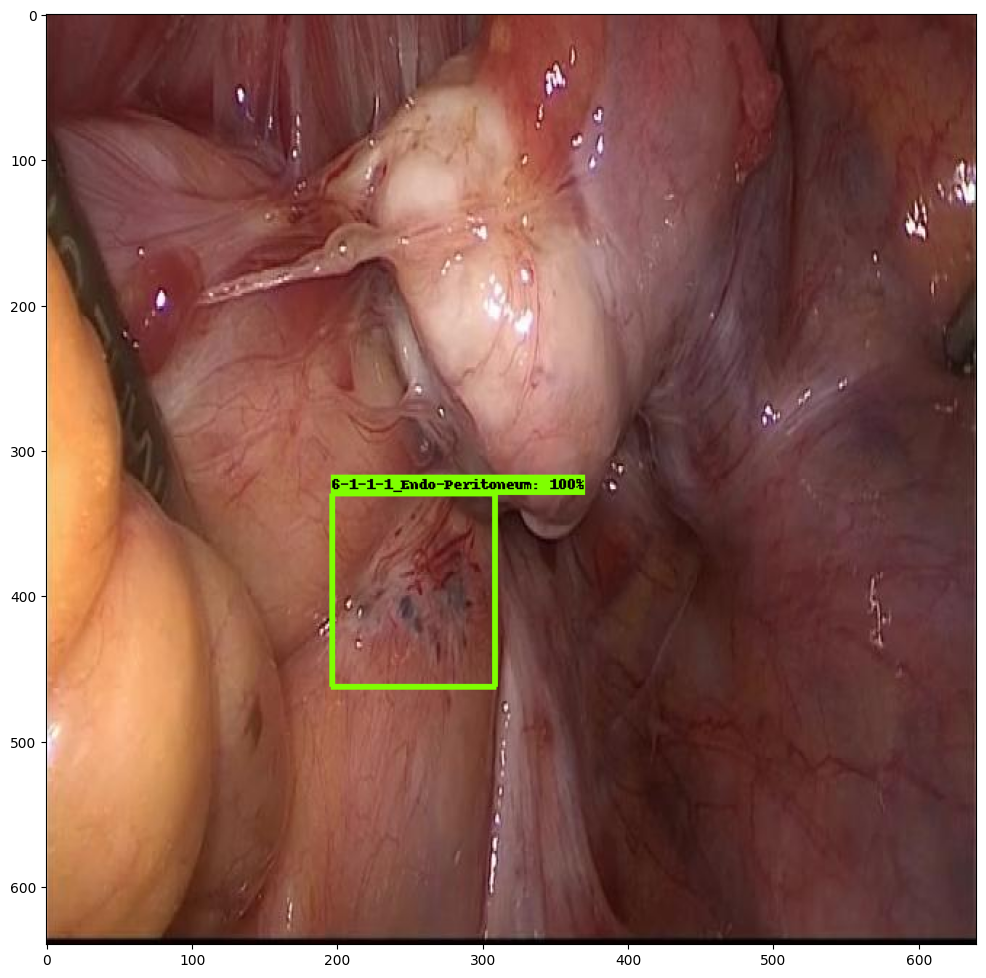

In [53]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

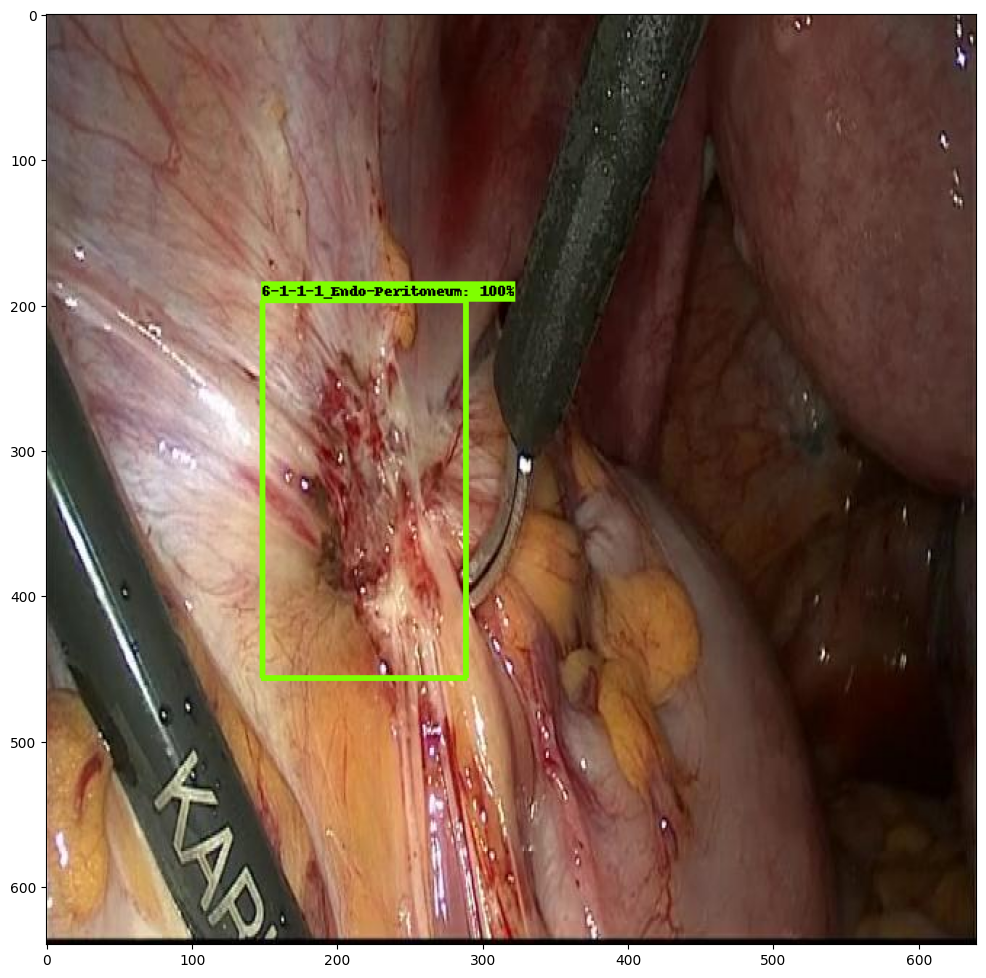

In [54]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

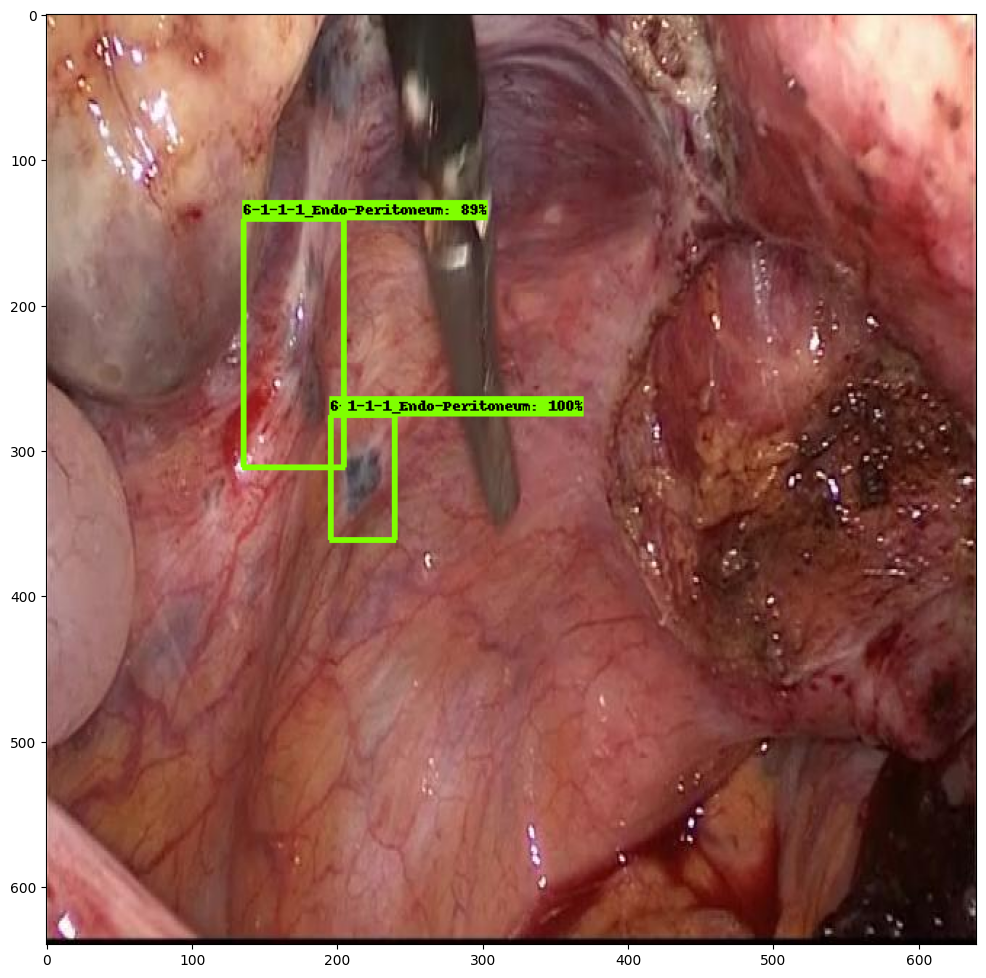

In [55]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

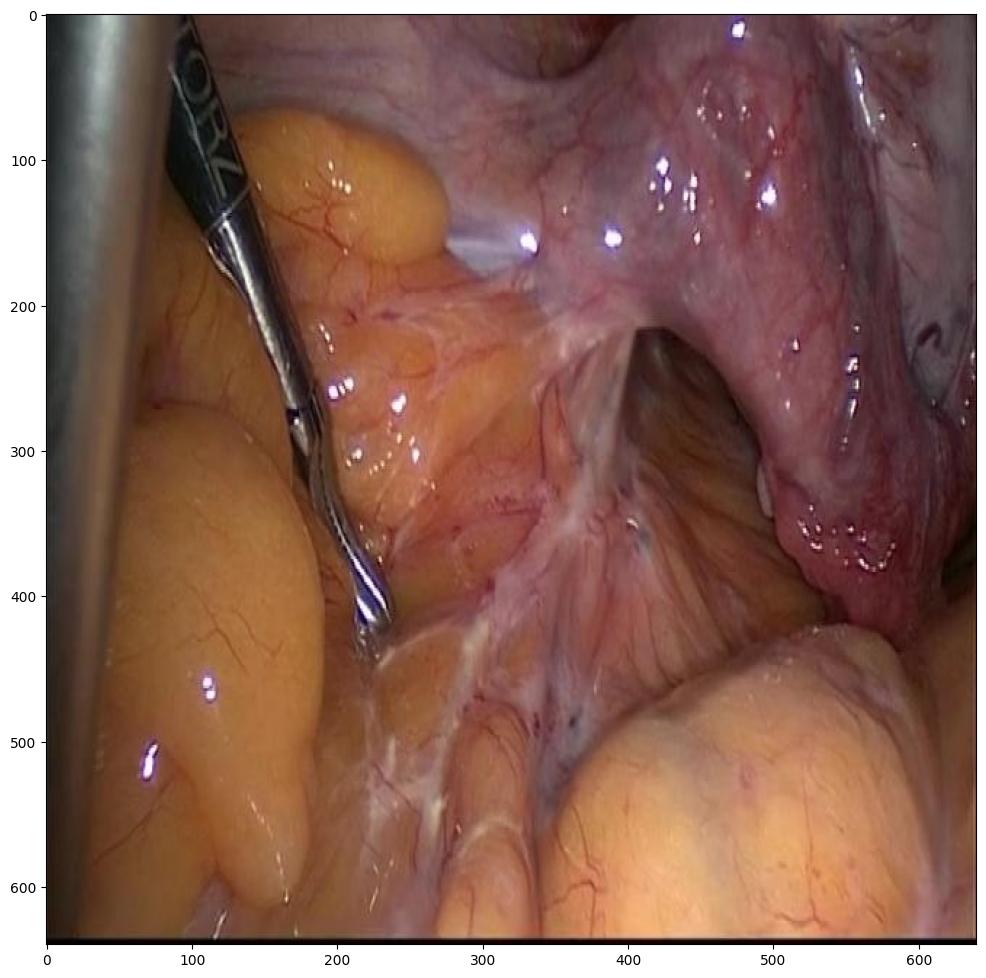

In [56]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

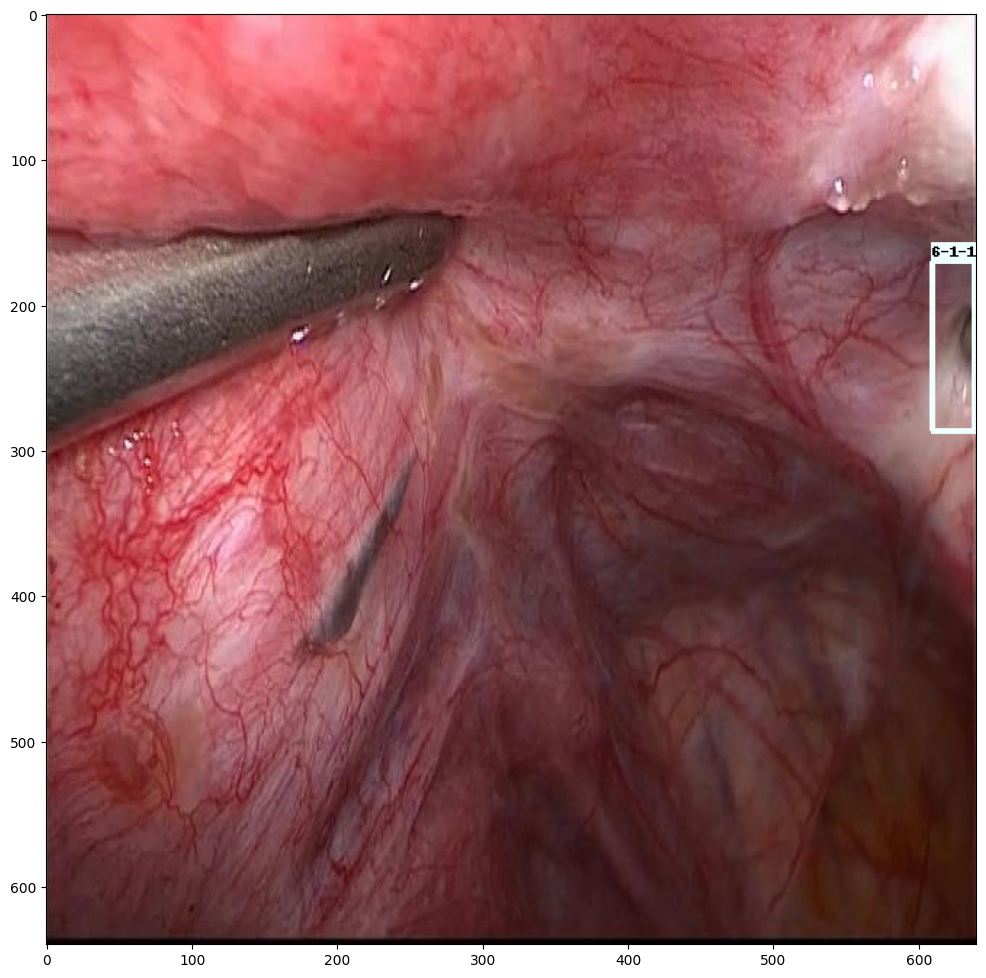

In [57]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

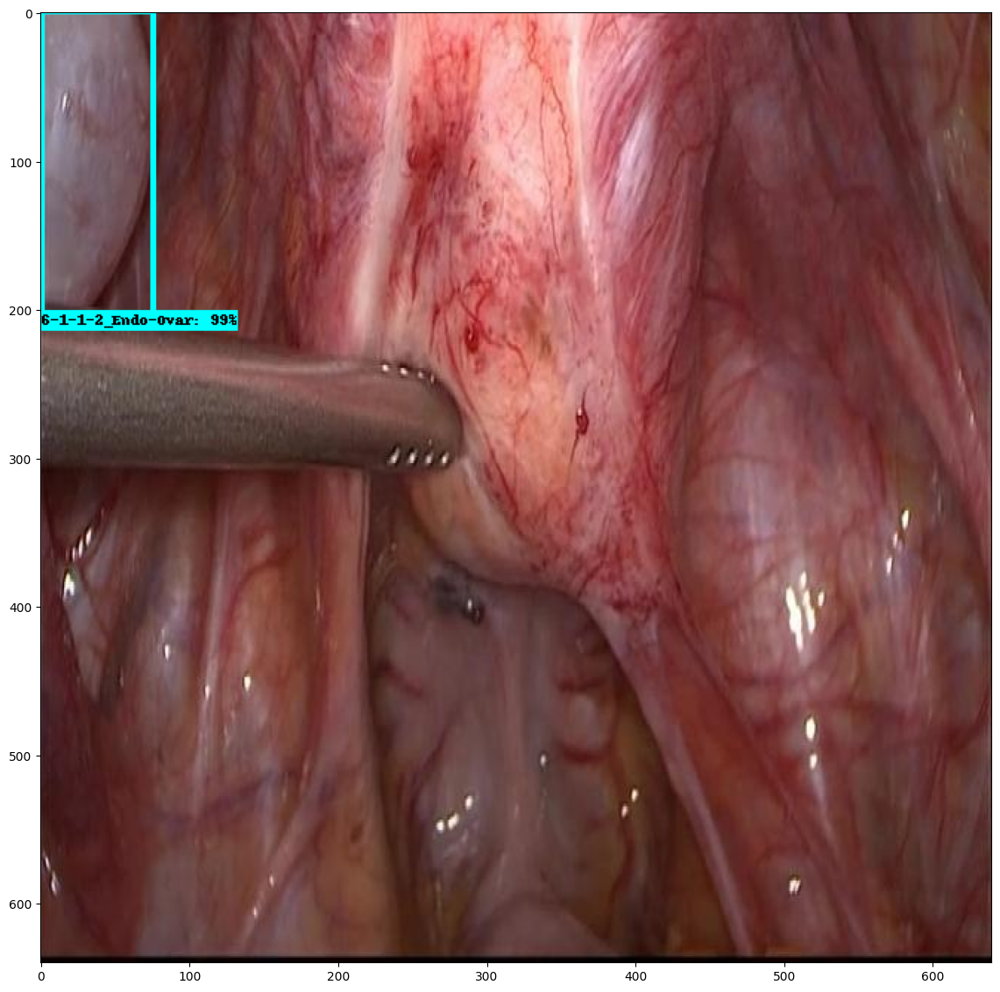

In [58]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(14,16))
plt.imshow(image_np_with_detections)
plt.show()

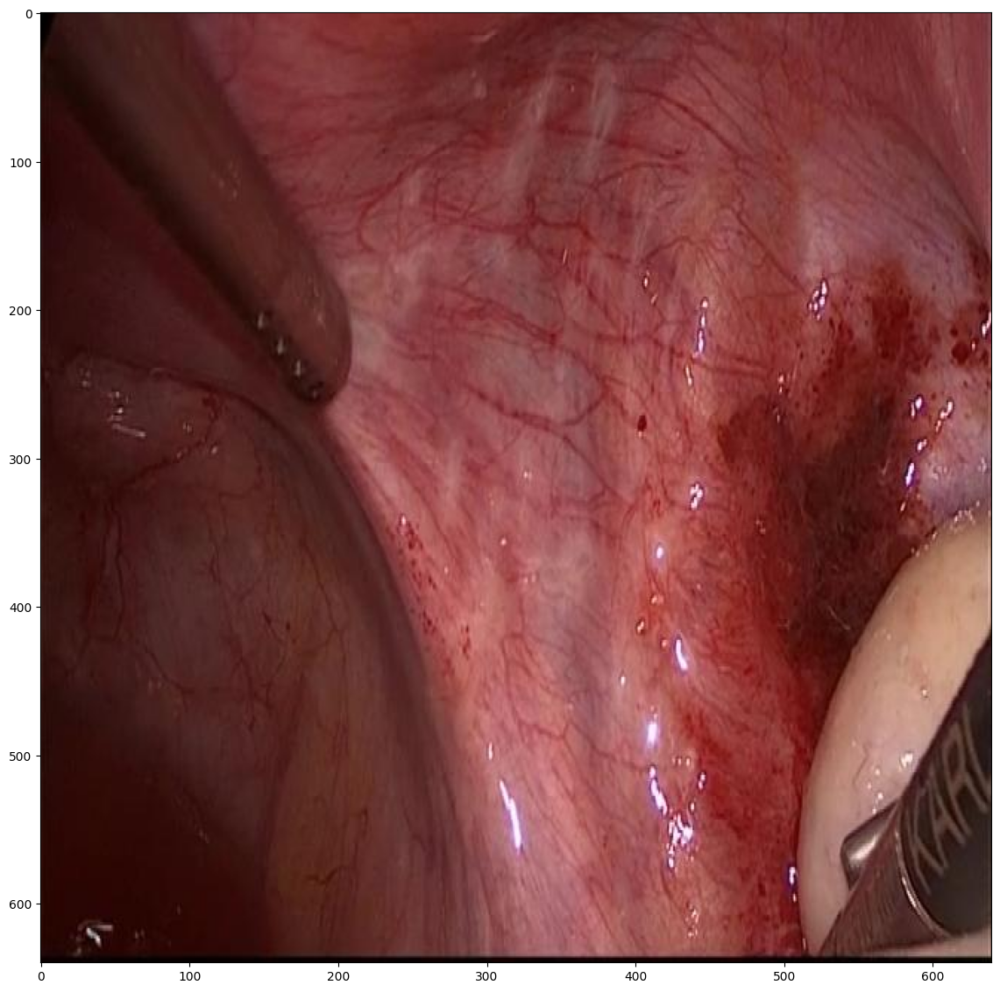

In [59]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(14,16))
plt.imshow(image_np_with_detections)
plt.show()

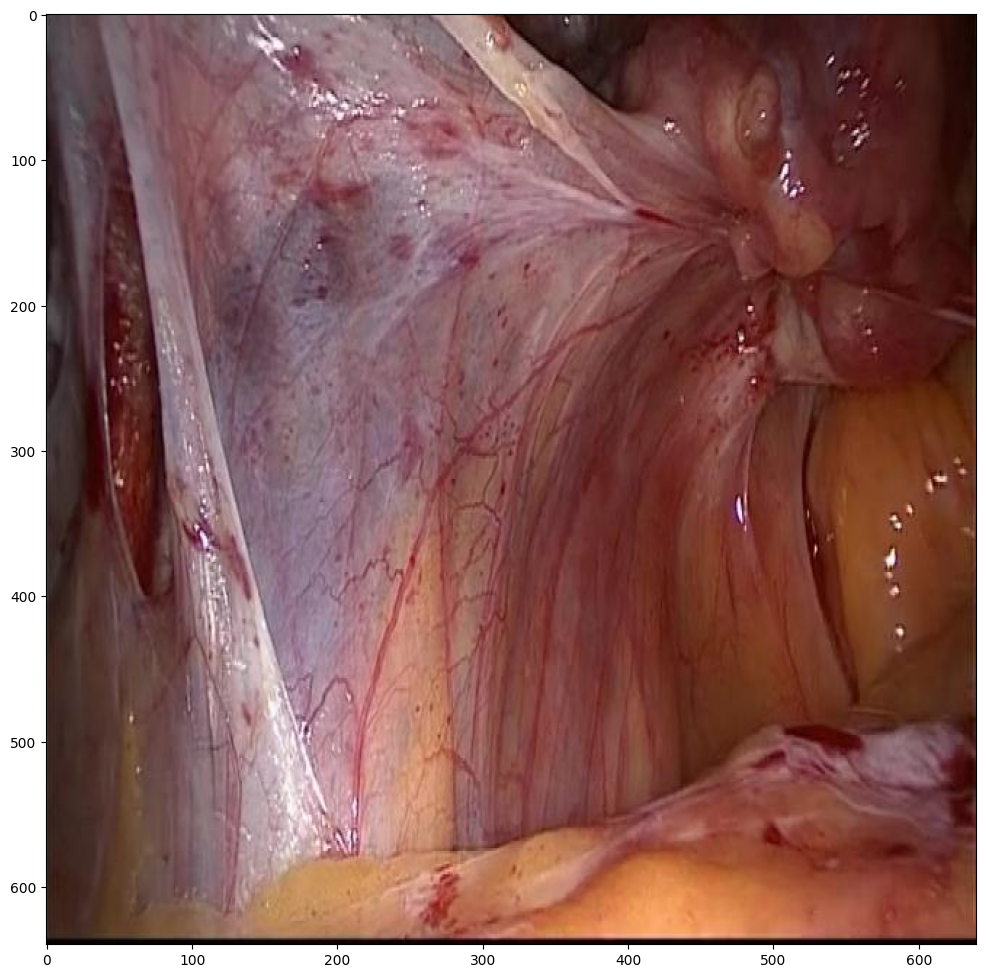

In [60]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

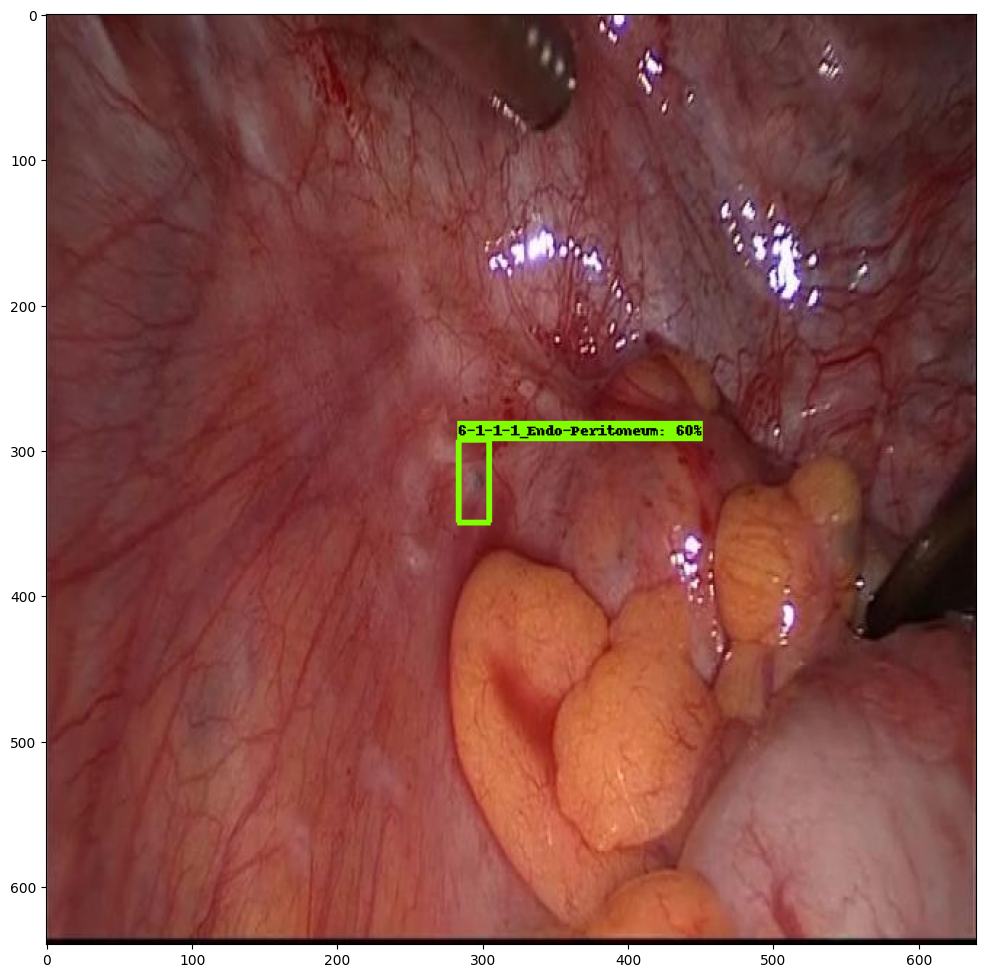

In [61]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

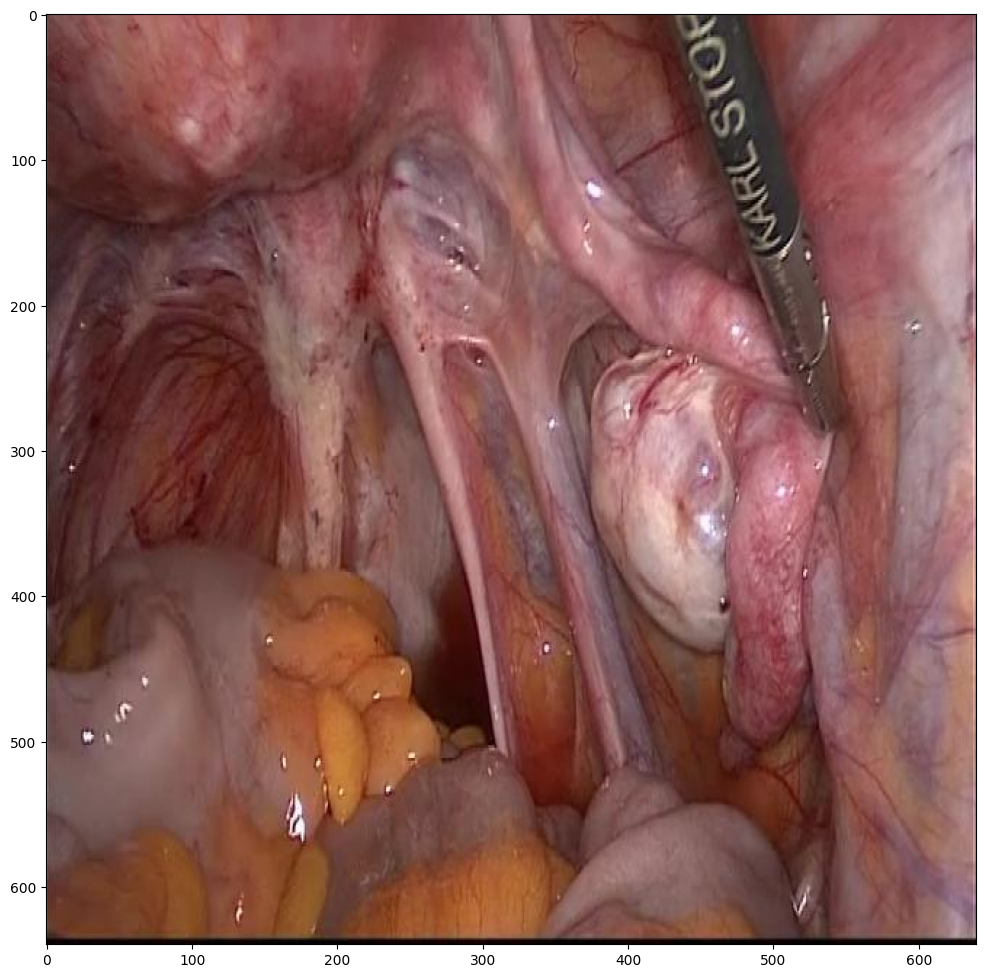

In [62]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

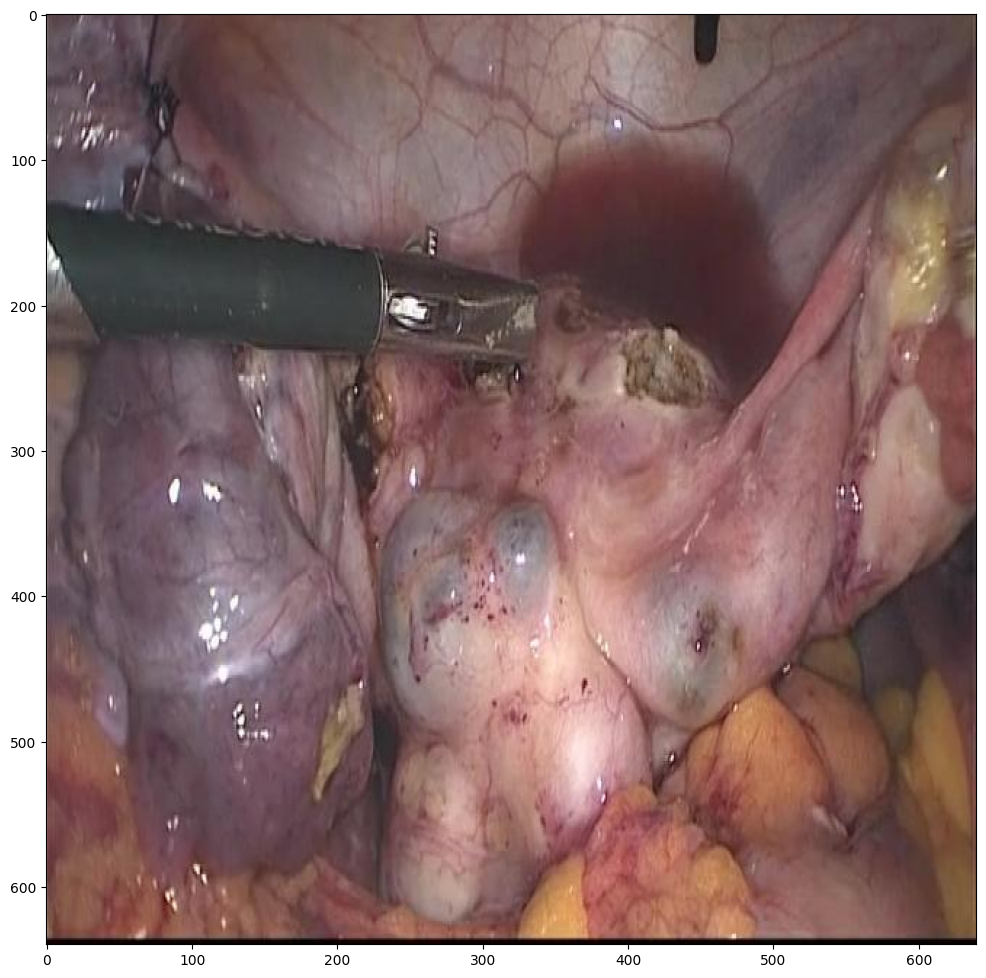

In [63]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

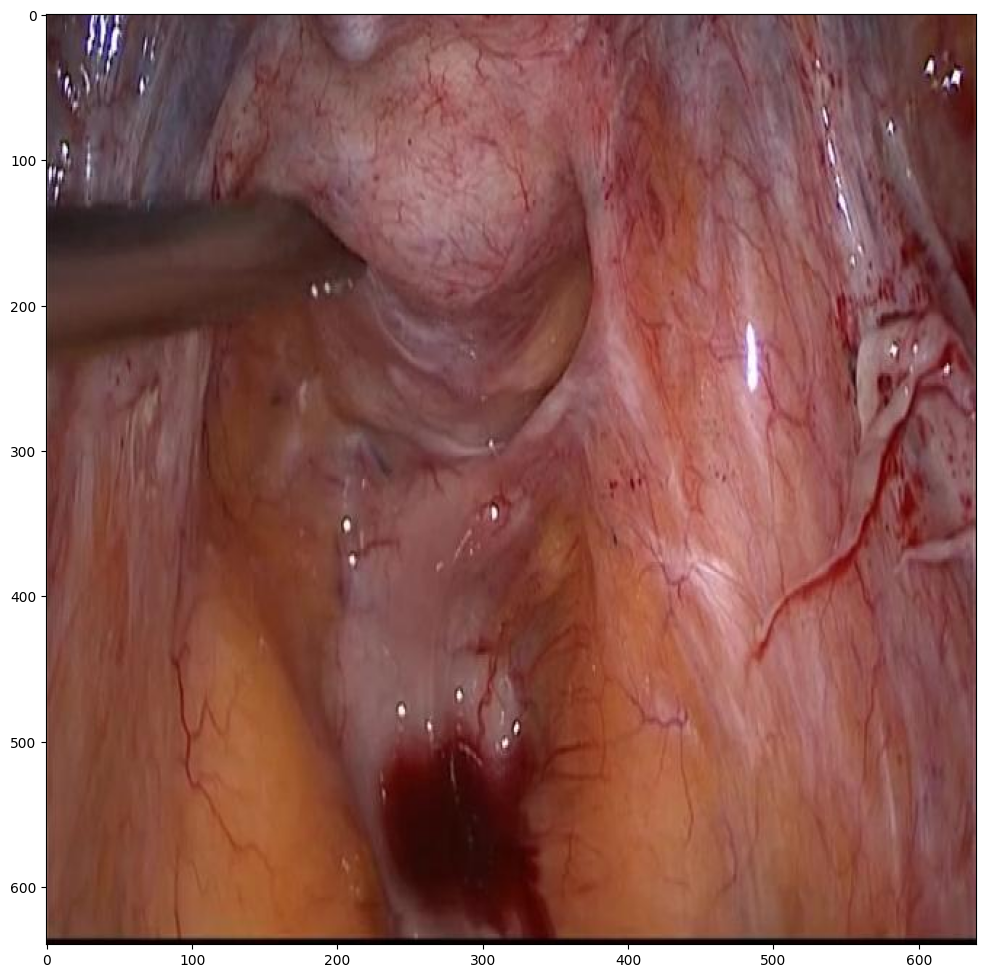

In [64]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

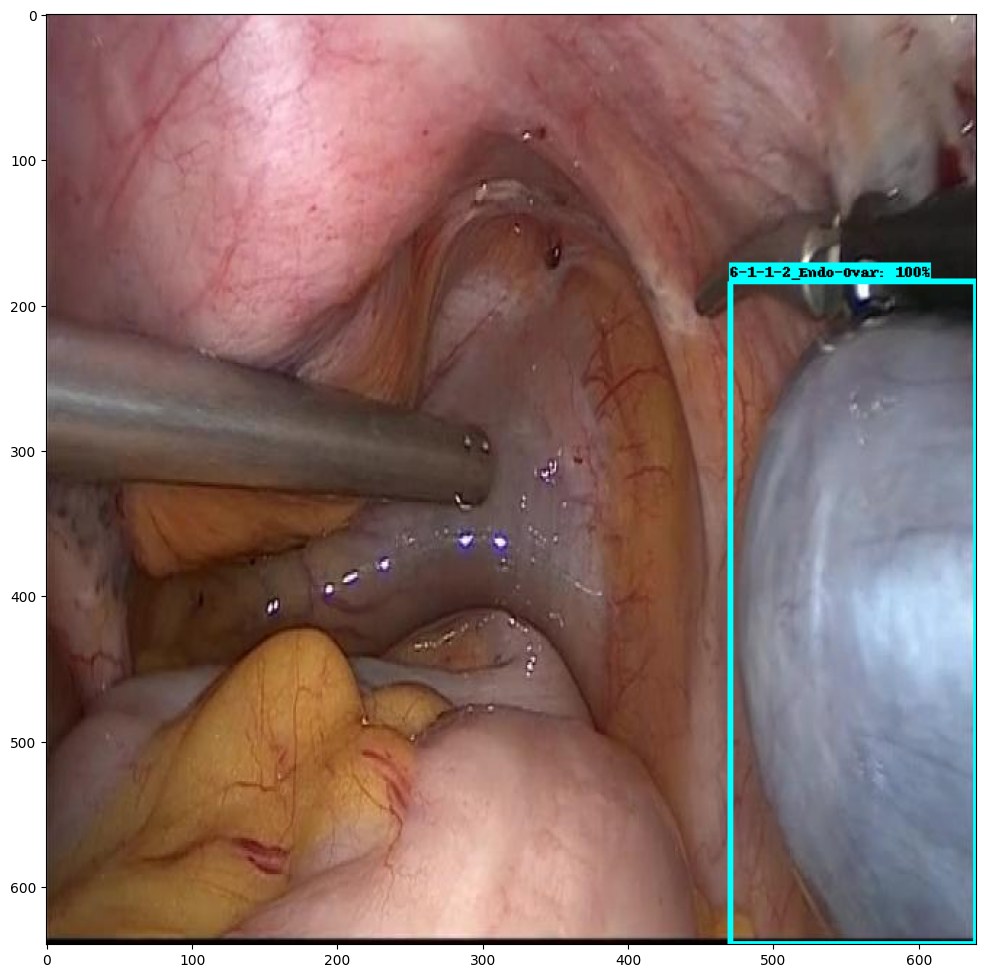

In [65]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

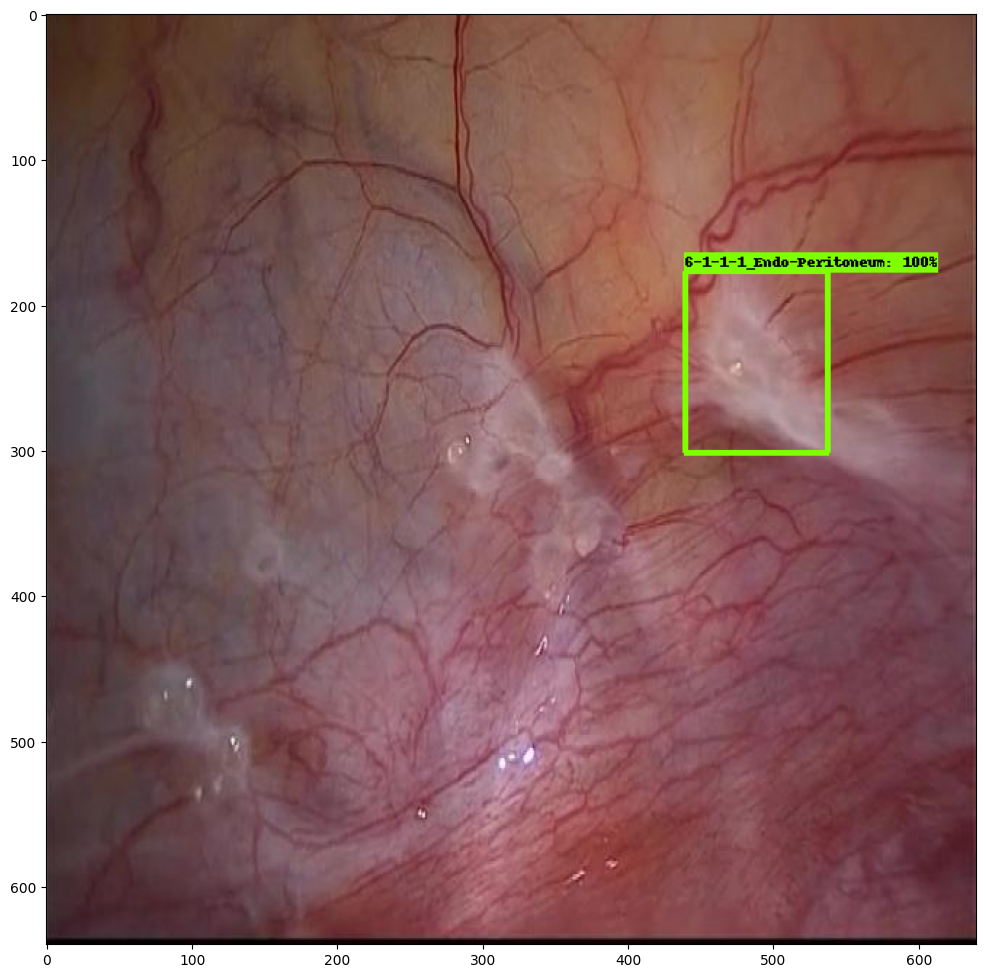

In [67]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

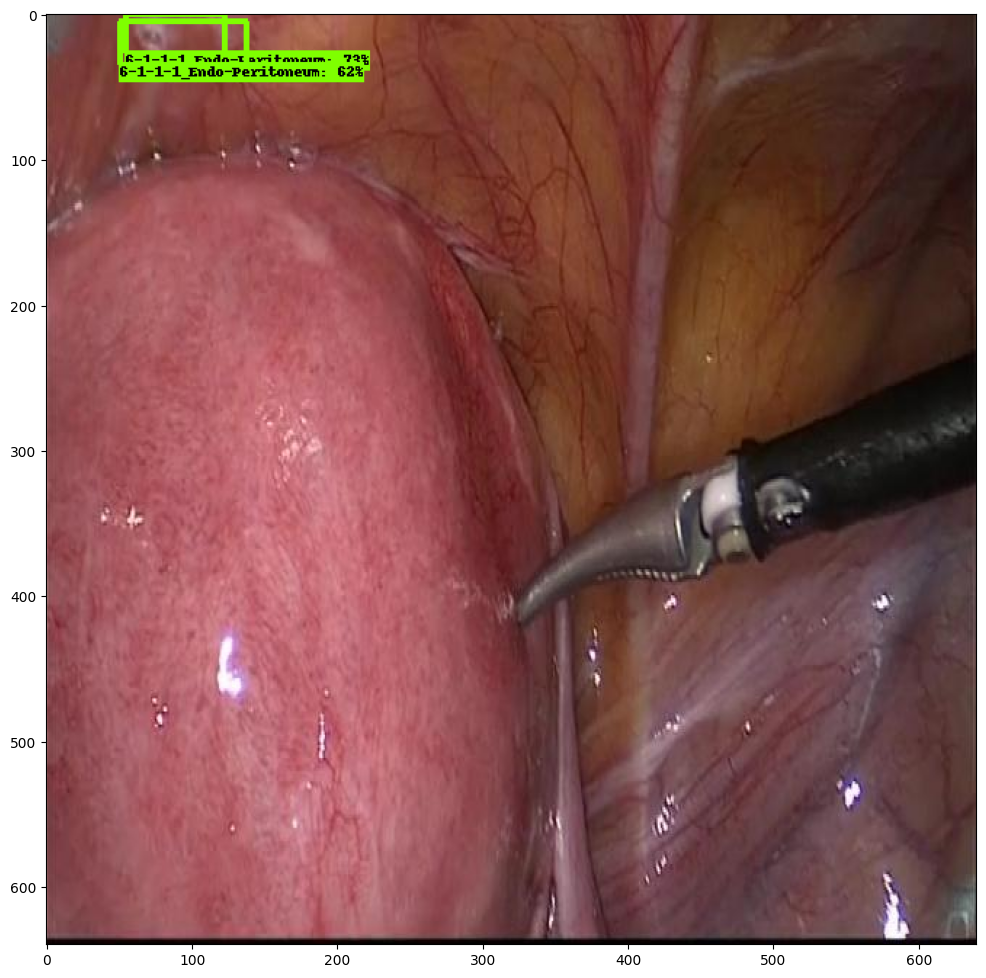

In [73]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

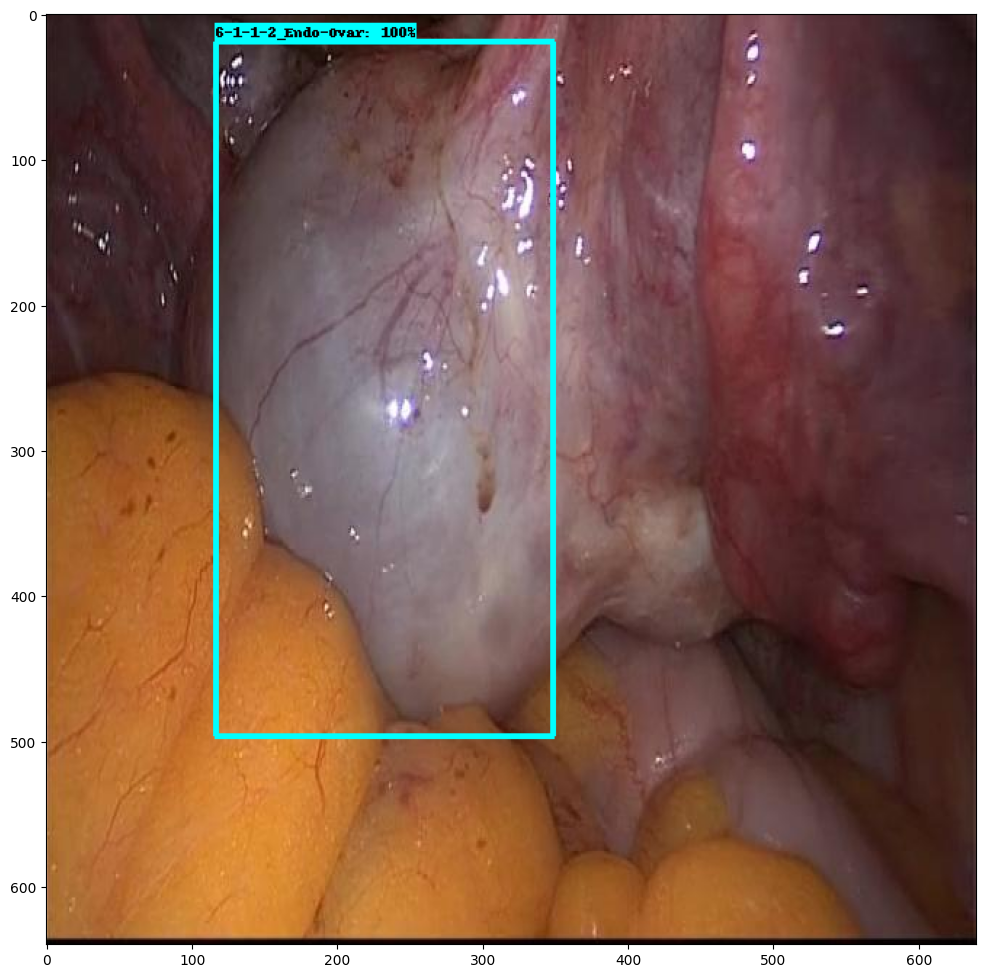

In [77]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

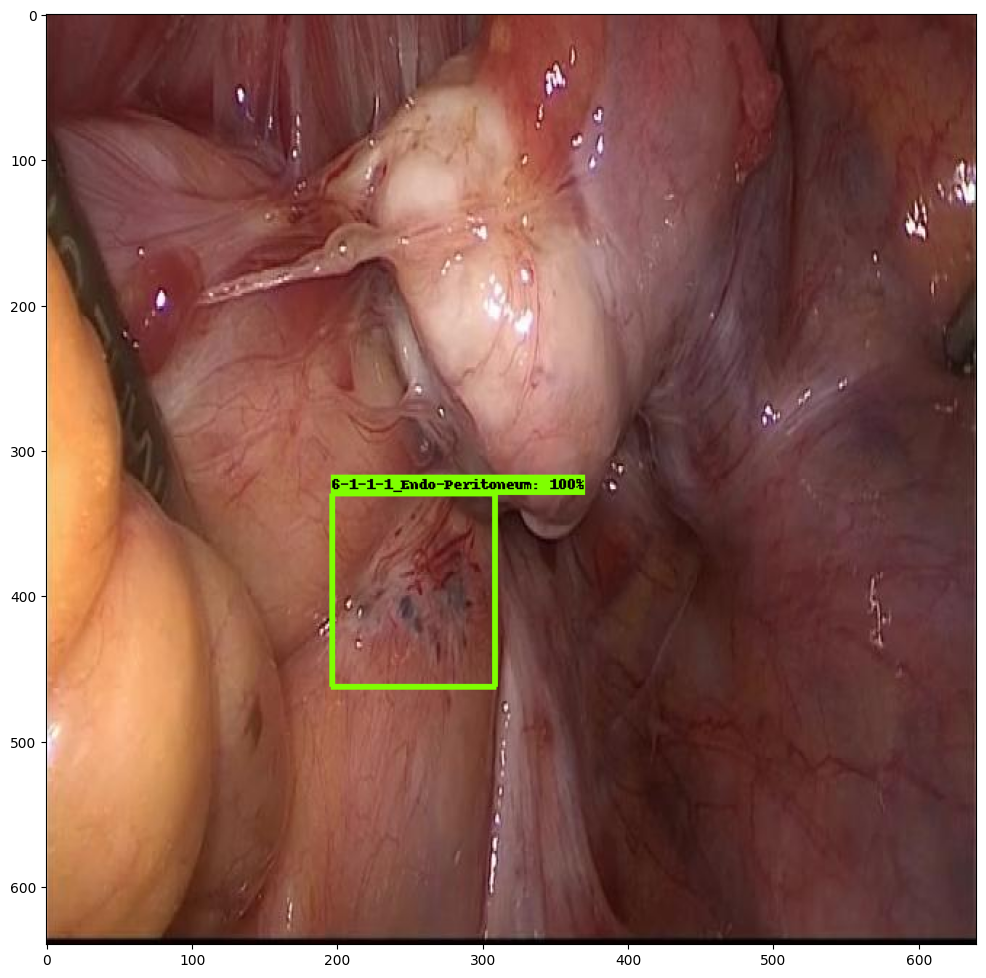

In [78]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

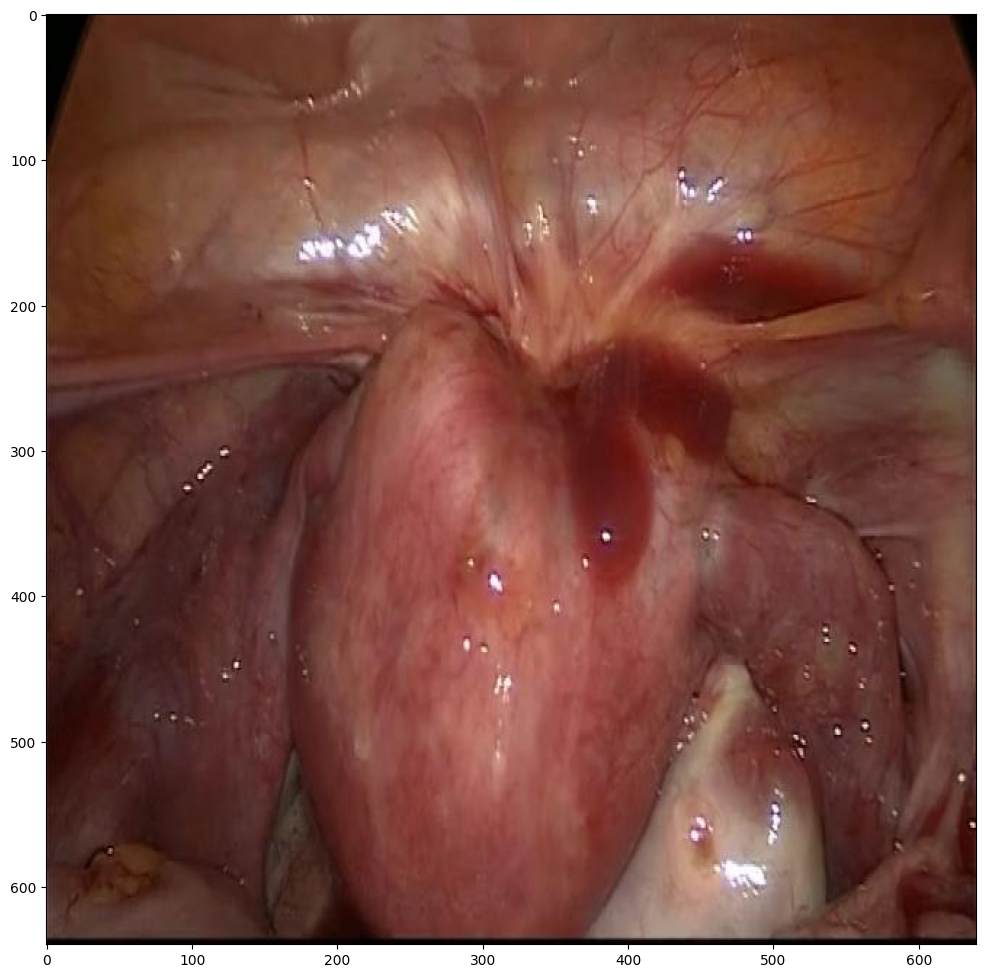

In [79]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

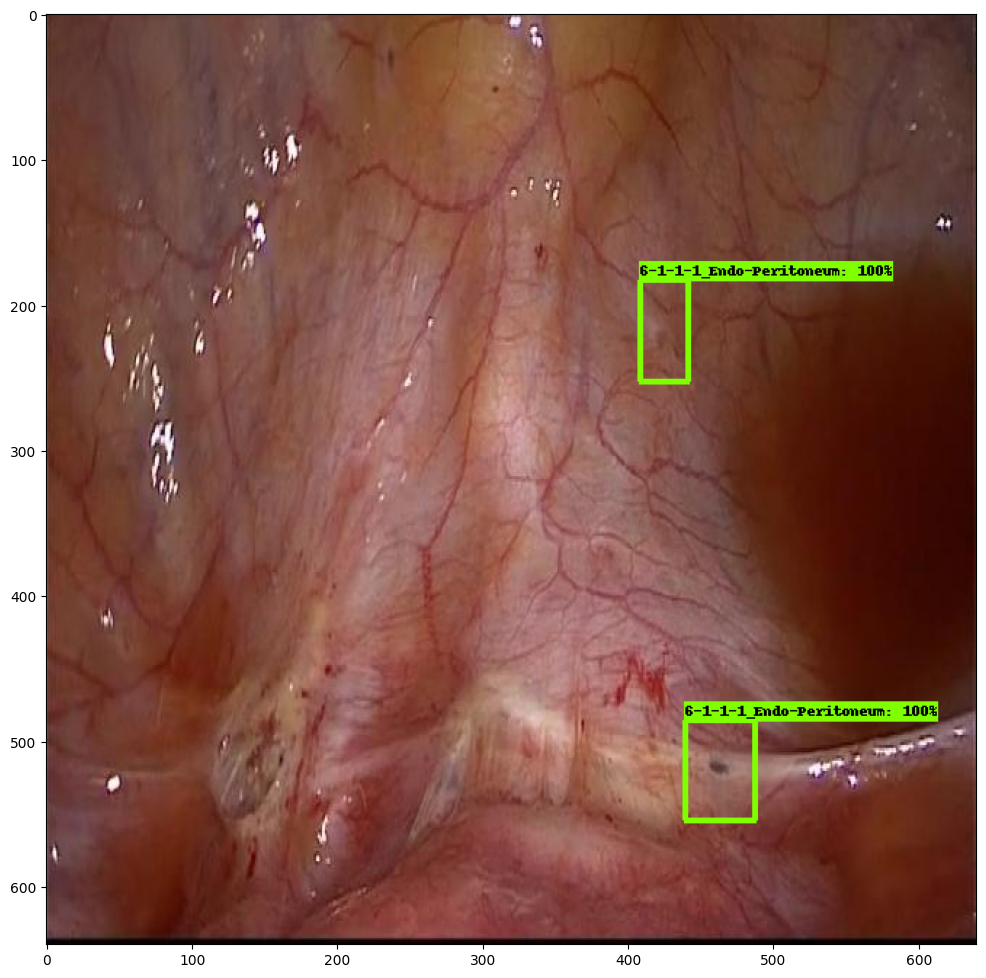

In [81]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

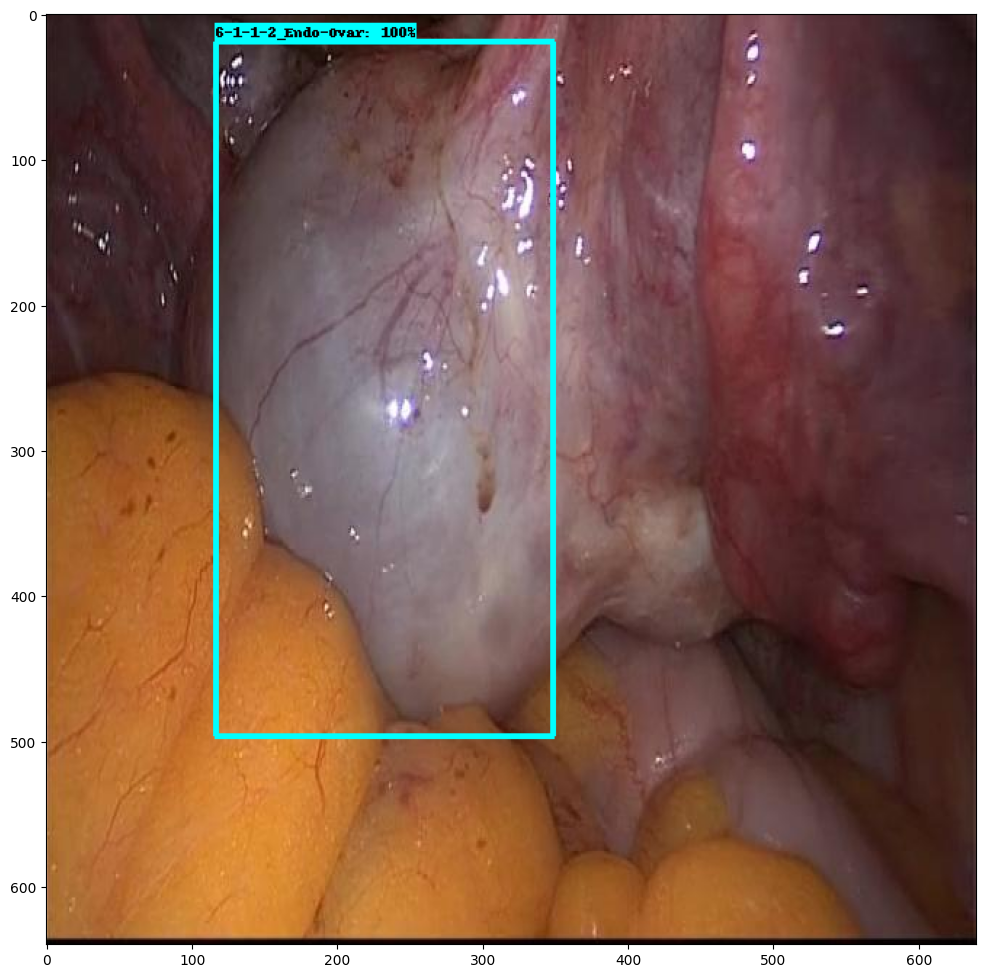

In [83]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

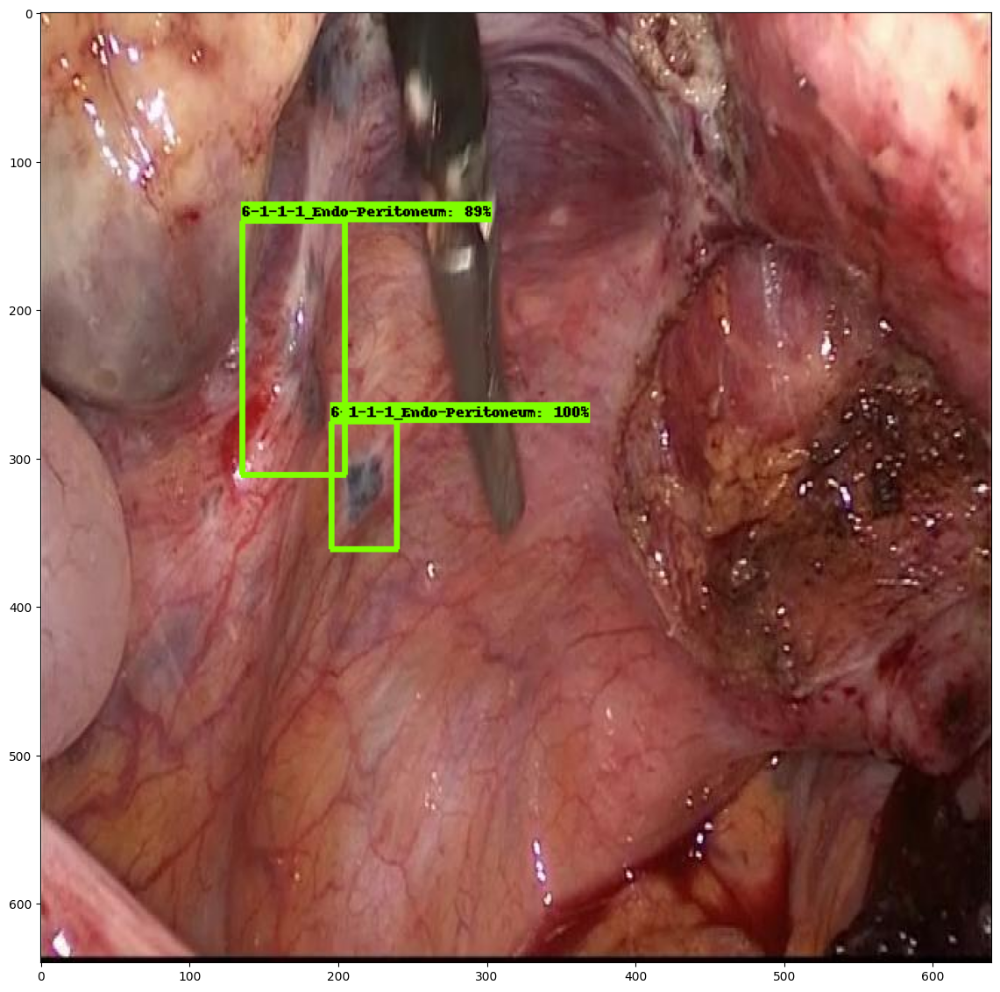

In [84]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed.
import random

TEST_IMAGE_PATHS = glob.glob('/home/759635/test/Endo-1/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(14,16))
plt.imshow(image_np_with_detections)
plt.show()